# Exploratory Data Analysis and Preprocessing

1. Import library
2. Define functions
3. Load data
4. Data exploration
5. Data preprocessing
6. Save data

## 1.Import libraries

In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import glob
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import os
import matplotlib.dates as mdates
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pingouin as pg
import warnings
warnings.filterwarnings('ignore')


## 2. Define functions

In [ ]:
def convert_lon(ds):
    """Convert longitude values to the range [-180, 180]"""
    return ds.assign_coords(lon=(((ds.lon + 180) % 360) - 180)).sortby("lon")

def extract_uk_mainland(ds):
    """Apply mask to extract UK mainland (excluding Ireland and France)"""
    ukish = (ds.lat >= 49.9) & (ds.lat <= 59.5) & (ds.lon >= -8.6) & (ds.lon <= 1.8)
    not_ireland = ~((ds.lat >= 50.0) & (ds.lat <= 54.0) & (ds.lon >= -10.0) & (ds.lon <= -6.0))
    not_france = ~((ds.lat < 50.5) & (ds.lon > 1.2))
    return ds.where(ukish & not_ireland & not_france, drop=False)

def prepare_plot_grid(data_array):
    """Generate 2D grid and mask NaN for plotting"""
    lon = data_array["lon"].values
    lat = data_array["lat"].values
    lon2d, lat2d = np.meshgrid(lon, lat)
    masked = np.ma.masked_invalid(data_array.values)
    return lon2d, lat2d, masked

def spatial_temp_plot(lon2d, lat2d, masked_data, varname, title, extent=[-11, 3, 49, 61], cmap="plasma"):
    """Plot spatial data on a map"""
    fig, ax = plt.subplots(figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})
    cmap_obj = plt.get_cmap(cmap).copy()
    cmap_obj.set_bad(color='lightgrey')  # for NaNs
    c = ax.pcolormesh(lon2d, lat2d, masked_data, cmap=cmap_obj, shading="auto")
    ax.coastlines(resolution='10m')
    ax.add_feature(cfeature.BORDERS.with_scale('10m'), linestyle=':')
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    fig.colorbar(c, ax=ax, label=f"{varname}")
    ax.set_title(title)
    plt.tight_layout()
    plt.show()

def data_distribution_plot(all_points, valid_points, title="Point Comparison", extent=[-11, 3, 48, 61]):
    """Compare original vs valid points on a map"""
    plt.figure(figsize=(10, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    ax.coastlines(resolution='10m')
    ax.add_feature(cfeature.BORDERS.with_scale('10m'), linestyle=':')

    ax.scatter(all_points['lon'], all_points['lat'], color='green', s=30, label='All Points', transform=ccrs.PlateCarree())
    ax.scatter(valid_points['lon'], valid_points['lat'], color='red', s=30, label='Valid UK-only Points', transform=ccrs.PlateCarree())

    ax.legend()
    ax.set_title(title)
    plt.show()

def plot_variable_trends(var_name,file_type):
    """Visualize trends (annual, monthly, daily smoothed) for a variable across simulators"""
    
    # Define the file pattern based on the file type
    if file_type == "UKonly":
        pattern = "*_UKonly_with_ymd.nc"
    elif file_type == "merged":
        pattern = "*_merged_with_ymd.nc"
    else:
        raise ValueError("file_type must be 'UKonly' or 'merged'")

    # Find all files matching the pattern
    uk_files = sorted(glob.glob(pattern))
    all_dfs = []

    for file in uk_files:
        ds = xr.open_dataset(file, decode_times=False)
        if var_name not in ds.data_vars:
            print(f"{var_name} not found in {file}")
            continue

        # Convert dataset to DataFrame and prepare for plotting
        df = ds.to_dataframe().reset_index()
        df = df.dropna(subset=[var_name])
        df['date'] = pd.to_datetime(df[['year', 'month', 'day']])
        df['simulator'] = file.split("_")[0]
        all_dfs.append(df)

    #Combine all DataFrames into one
    full_df = pd.concat(all_dfs, ignore_index=True)

    # Annual Mean Plot
    annual_df = (
        full_df.groupby(['simulator', full_df['date'].dt.year])[var_name]
        .mean()
        .reset_index()
        .rename(columns={'date': 'year'})
    )

    plt.figure(figsize=(12, 6))
    for simulator in annual_df['simulator'].unique():
        sub = annual_df[annual_df['simulator'] == simulator]
        plt.plot(sub['year'], sub[var_name], alpha=0.6)
        # Plot overall mean trend for each simulator
    overall = (
        annual_df.groupby('year')[var_name]
        .mean()
        .reset_index()
    )
    plt.plot(overall['year'], overall[var_name], color='black', linewidth=2.5, label='Mean Trend')
    
    # Add linear trend line
    x = mdates.date2num(overall['year'])
    y = overall[var_name].values
    a, b = np.polyfit(x, y, deg=1)
    trend_y = a * x + b
    plt.plot(overall['year'], trend_y, color='red', linestyle='--', linewidth=2.5, label='Linear Trend')
    
    # Add horizontal line from start point of the trend line
    start_value = trend_y[0] 
    plt.axhline(start_value, color='gray', linestyle='--', linewidth=1.5, label='Trend Start Level')
    plt.xlabel("Year")
    plt.ylabel(f"{var_name} (Annual Mean)")
    plt.title(f"{var_name} Annual Mean by simulator")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Monthly Mean Plot
    monthly_df = (
        full_df.groupby(['simulator', full_df['date'].dt.month])[var_name]
        .mean()
        .reset_index()
        .rename(columns={'date': 'month'})
    )

    plt.figure(figsize=(12, 6))
    for simulator in monthly_df['simulator'].unique():
        sub = monthly_df[monthly_df['simulator'] == simulator]
        plt.plot(sub['month'], sub[var_name], alpha=0.5)
    plt.xlabel("Month")
    plt.ylabel(f"{var_name} (Monthly Mean)")
    plt.title(f"{var_name} Monthly Pattern by simulator")
    plt.legend()
    plt.xticks(range(1, 13))
    plt.tight_layout()
    plt.show()

    # Daily Trend Plot
    daily_df = (
        full_df.groupby(['simulator', 'date'])[var_name]
        .mean()
        .reset_index()
    )
    plt.figure(figsize=(14, 6))

    smoothed_all = []

    for simulator in daily_df['simulator'].unique():
        sub = daily_df[daily_df['simulator'] == simulator]
        sub = sub.sort_values('date')
        sub[var_name] = sub[var_name].rolling(window=30, min_periods=1).mean()
        smoothed_all.append(sub)
        plt.plot(sub['date'], sub[var_name], alpha=0.3)

    # Combine allsmoothed data for overall trend
    all_concat = pd.concat(smoothed_all)
    overall_daily = (
        all_concat.groupby('date')[var_name]
        .mean()
        .reset_index()
    )

    # Add linear trend line for overall daily mean
    x = mdates.date2num(overall_daily['date'])
    y = overall_daily[var_name].values
    a, b = np.polyfit(x, y, deg=1)
    trend_y = a * x + b
    plt.plot(overall_daily['date'], trend_y, color='red', linestyle='--', linewidth=2.5, label='Linear Trend')
    
    # Add horizontal line from start point of the trend line
    start_value = trend_y[0] 
    plt.axhline(start_value, color='gray', linestyle='--', linewidth=1.5, label='Trend Start Level')
    plt.xlabel("Date")
    plt.ylabel(f"{var_name} (Smoothed Daily Mean)")
    plt.title(f"{var_name} Daily Trends by simulator (Smoothed)")
    plt.legend()
    plt.tight_layout()
    plt.show()

## 3. Load data


### Summarise NetCDF Datasets

In [3]:
# List all _merged.nc files
files = sorted(glob.glob("*_merged.nc"))

# Load datasets
datasets = {file: xr.open_dataset(file, decode_times=False) for file in files}

# Summarise datasets
dataset_summary = {}

for name, ds in datasets.items():
    dataset_summary[name] = {
        "Variables": list(ds.variables.keys()),
        "Dimensions": ds.dims,
        "Latitude Range": (ds["lat"].values.min(), ds["lat"].values.max()),
        "Longitude Range": (ds["lon"].values.min(), ds["lon"].values.max()),
        "Time Range": (ds["time"].values.min(), ds["time"].values.max()),
    }

# Convert to a DataFrame
summary_df = pd.DataFrame(dataset_summary).T

# Display summary
summary_df

,Variables,Dimensions,Latitude Range,Longitude Range,Time Range
003_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
004_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
005_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
006_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
007_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
008_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
009_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
010_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
011_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"
012_merged.nc,"[TREFMXAV_U, FLNS, FSNS, PRECT, PRSN, QBOT, TR...","(time, lat, lon)","(49.47644, 58.900524)","(0.0, 358.75)","(1.0, 27374.0)"


### Identify Missing Values and Duplicate Time Entries

In [4]:
# Check for missing values and duplicate time entries
dataset_analysis = {}

for name, ds in datasets.items():
    # Count missing values for each variable
    missing_values = {var: int(ds[var].isnull().sum().compute()) for var in ds.variables}

    # Check for duplicate time entries
    time_values = ds["time"].values
    unique_time_values = np.unique(time_values)
    duplicate_time_count = len(time_values) - len(unique_time_values)

    dataset_analysis[name] = {
        "Total Missing Values": sum(missing_values.values()),
        "Missing Values by Variable": missing_values,
        "Duplicate Time Entries": duplicate_time_count,
    }

# Convert analysis to a DataFrame
analysis_df = pd.DataFrame(dataset_analysis).T

# Display results
analysis_df

,Total Missing Values,Missing Values by Variable,Duplicate Time Entries
003_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
004_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
005_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
006_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
007_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
008_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
009_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
010_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
011_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0
012_merged.nc,985464,"{'TREFMXAV_U': 985464, 'FLNS': 0, 'FSNS': 0, '...",0


### Decompose the 'time' variable in _merged.nc files  

In [5]:
# Process all *_UKonly.nc files
uk_files = sorted(glob.glob("*_merged.nc"))

for path in uk_files:
    ds = xr.open_dataset(path, decode_times=True)

    # Add year, month, day as new coordinates from the 'time' dimension
    ds = ds.assign_coords(
        year=("time", ds.time.dt.year.data),
        month=("time", ds.time.dt.month.data),
        day=("time", ds.time.dt.day.data)
    )

    #Save to a new file with "_with_ymd" suffix 
    outname = path.replace("_merged.nc", "_merged_with_ymd.nc")
    ds.to_netcdf(outname)
    print(f"Saved: {outname}")

Saved: 003_merged_with_ymd.nc
Saved: 004_merged_with_ymd.nc
Saved: 005_merged_with_ymd.nc
Saved: 006_merged_with_ymd.nc
Saved: 007_merged_with_ymd.nc
Saved: 008_merged_with_ymd.nc
Saved: 009_merged_with_ymd.nc
Saved: 010_merged_with_ymd.nc
Saved: 011_merged_with_ymd.nc
Saved: 012_merged_with_ymd.nc
Saved: 013_merged_with_ymd.nc
Saved: 014_merged_with_ymd.nc
Saved: 015_merged_with_ymd.nc
Saved: 016_merged_with_ymd.nc
Saved: 017_merged_with_ymd.nc
Saved: 018_merged_with_ymd.nc
Saved: 019_merged_with_ymd.nc
Saved: 020_merged_with_ymd.nc
Saved: 021_merged_with_ymd.nc
Saved: 022_merged_with_ymd.nc
Saved: 023_merged_with_ymd.nc
Saved: 024_merged_with_ymd.nc
Saved: 025_merged_with_ymd.nc
Saved: 026_merged_with_ymd.nc
Saved: 027_merged_with_ymd.nc
Saved: 028_merged_with_ymd.nc
Saved: 029_merged_with_ymd.nc
Saved: 030_merged_with_ymd.nc
Saved: 031_merged_with_ymd.nc
Saved: 032_merged_with_ymd.nc
Saved: 033_merged_with_ymd.nc


## 4.EDA for Original Data

### Calculate Spatial and Temporal Means for Each Variable

In [6]:
# Extract variable names from the first dataset
data_vars = list(xr.open_dataset(files[0]).data_vars)

# Containers to store results
spatial_means = {}
time_means = {}

# Process each variable
for var in data_vars:
    var_list = []
    for f in files:
        ds = xr.open_dataset(f, decode_times=False)
        var_list.append(ds[var])
    # Combine along a new 'sim' dimension-> (sim, time, lat, lon)
    combined = xr.concat(var_list, dim="sim")  
    
    # Spatial mean: average across all samples (sim, time)
    spatial_mean = combined.stack(all_samples=("sim", "time")).mean(dim="all_samples", skipna=True)
    spatial_means[var] = spatial_mean
    # Time mean: average across all samples (sim, lat, lon)
    time_mean = combined.mean(dim=["sim", "lat", "lon"], skipna=True)
    time_means[var] = time_mean

# Save both datasets
xr.Dataset(spatial_means).to_netcdf("Mean_spatial.nc")
xr.Dataset(time_means).to_netcdf("Mean_time.nc")
print(" Saved:Mean_spatial.nc")
print(" Saved:Mean_time.nc")


 Saved:Mean_spatial.nc
 Saved:Mean_time.nc


### Univariate Analysis

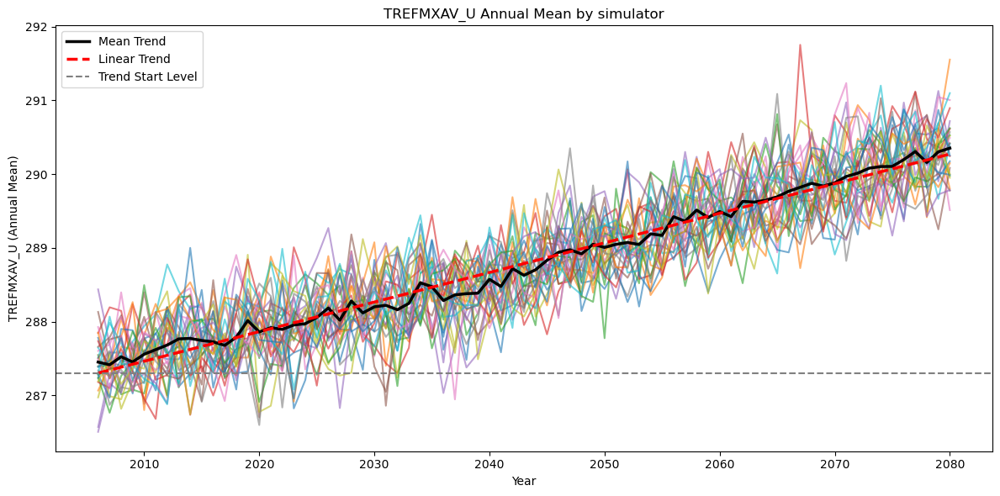

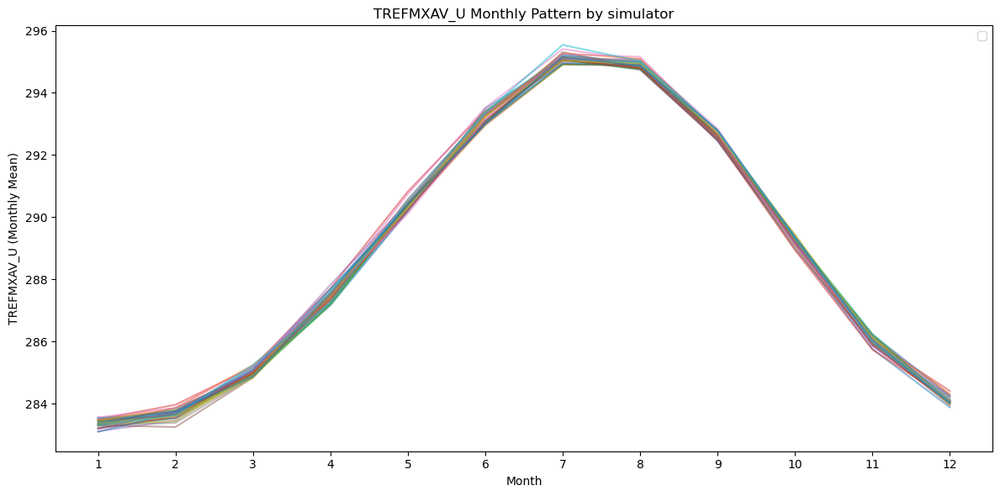

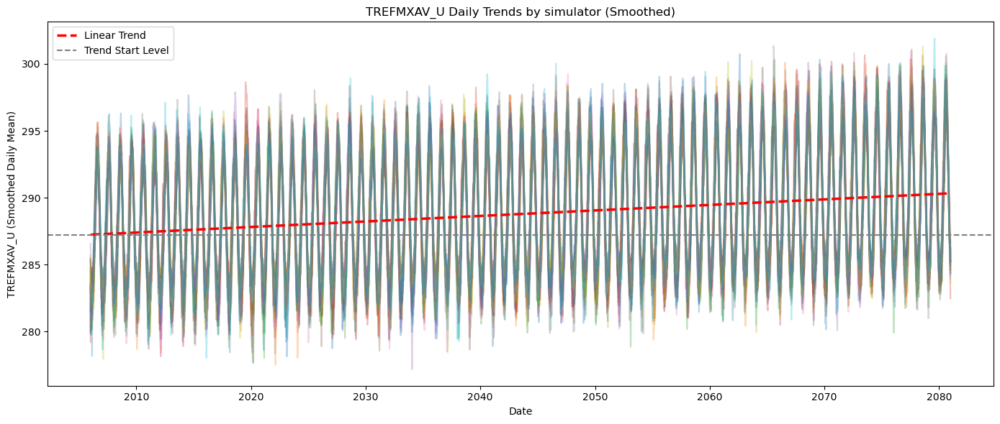

In [7]:
# Visualise Temporal Trends of `TREFMXAV_U`
plot_variable_trends("TREFMXAV_U",file_type="merged")

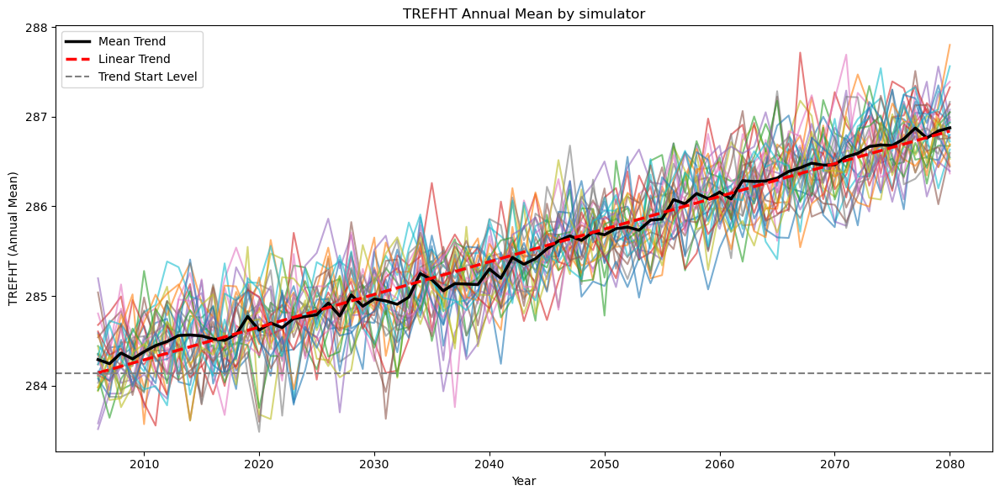

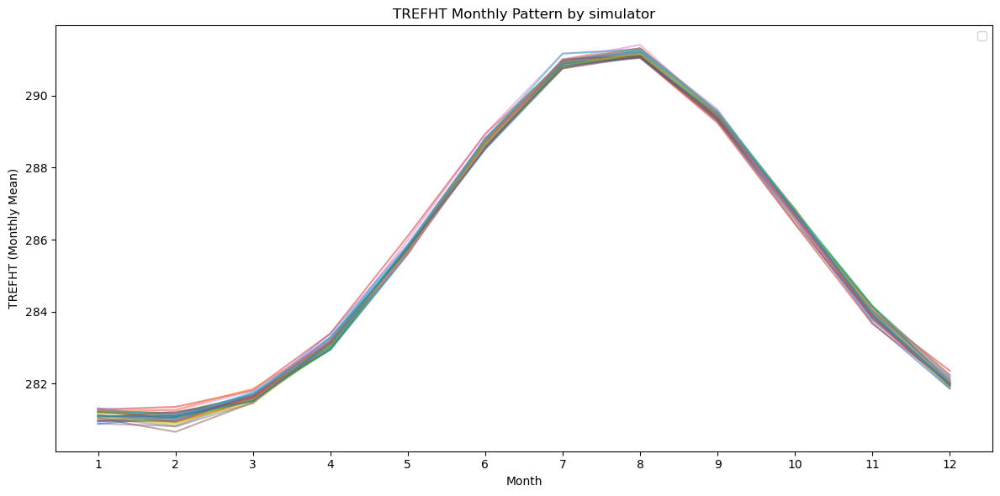

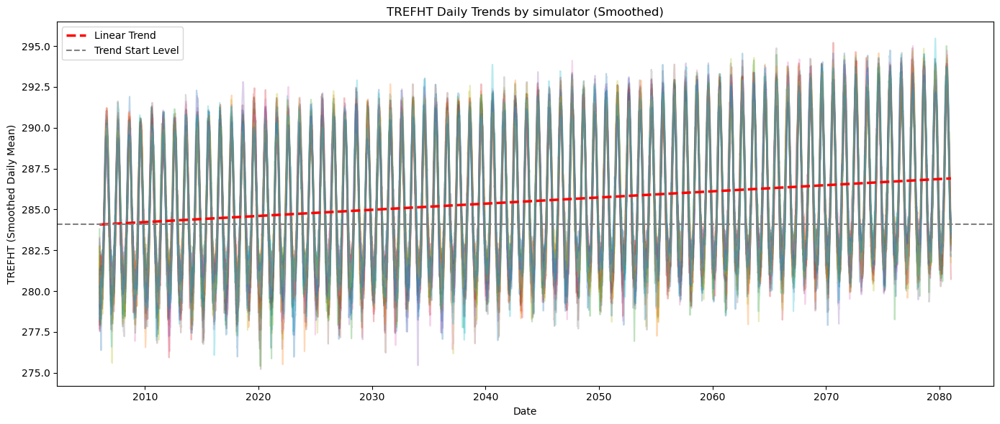

In [8]:
# Visualise Temporal Trends of `TREFHT`
plot_variable_trends("TREFHT",file_type="merged")

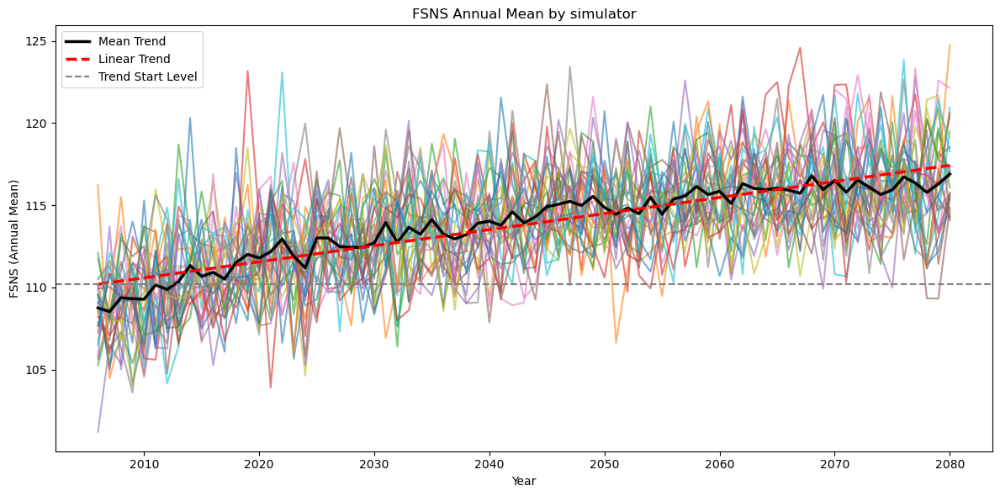

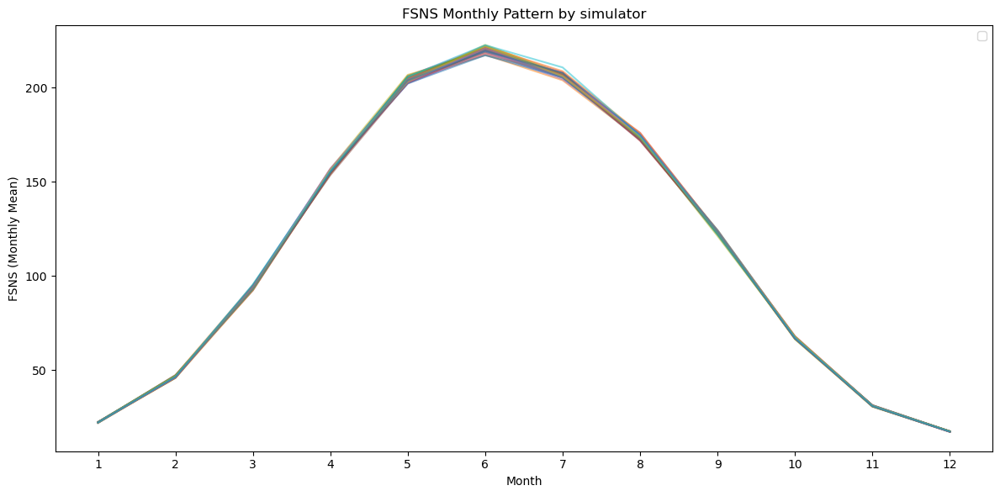

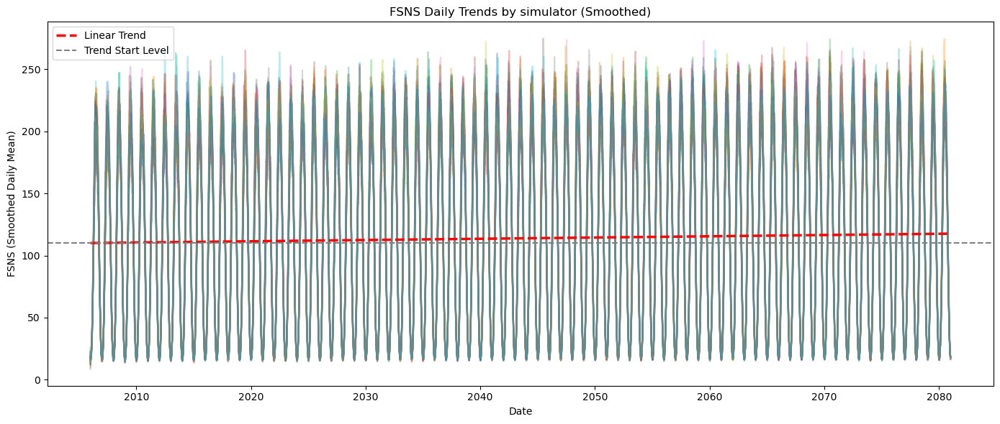

In [9]:
# Visualise Temporal Trends of `FSNS`
plot_variable_trends("FSNS",file_type="merged")

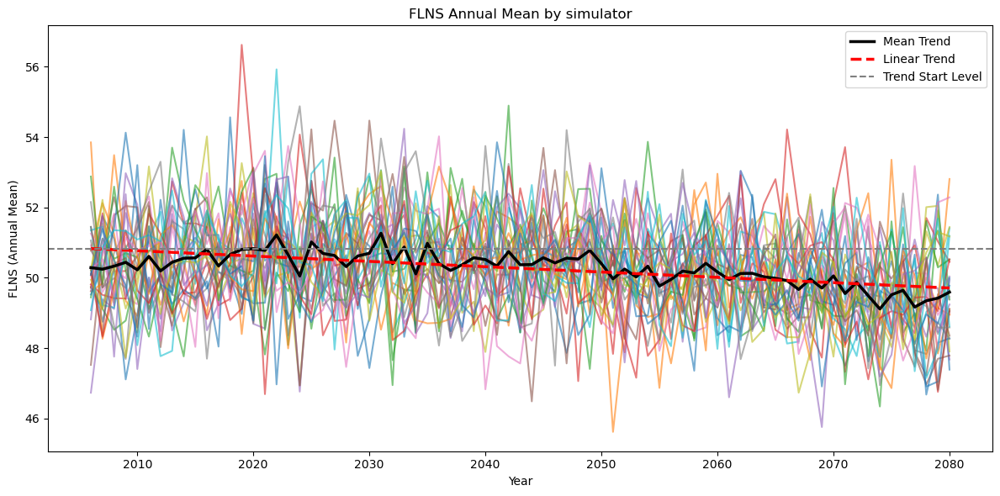

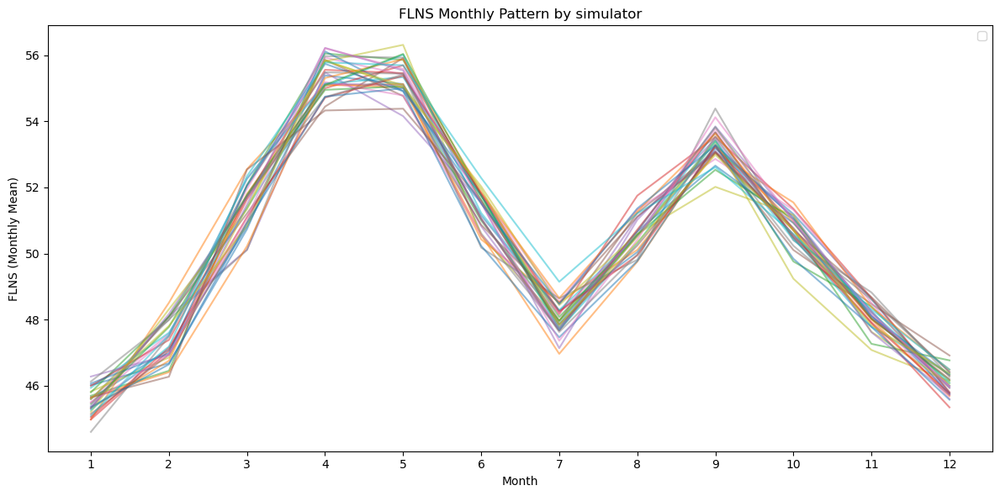

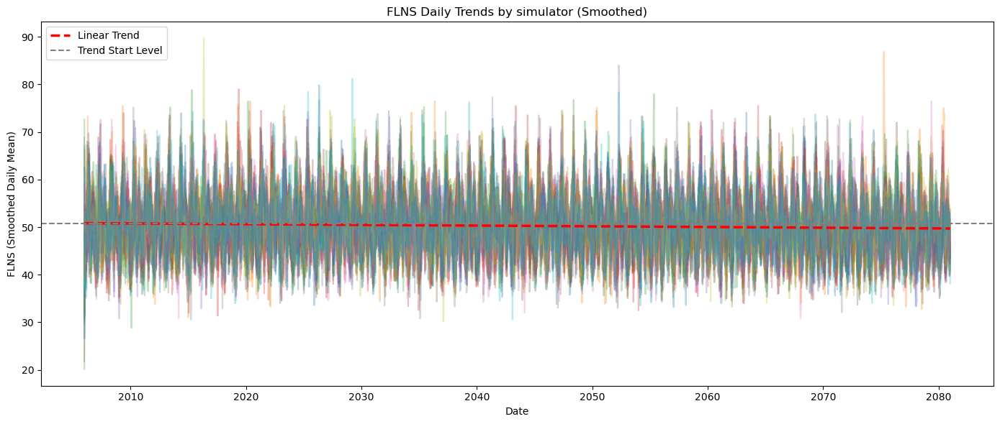

In [10]:
# Visualise Temporal Trends of `FLNS`
plot_variable_trends("FLNS",file_type="merged")

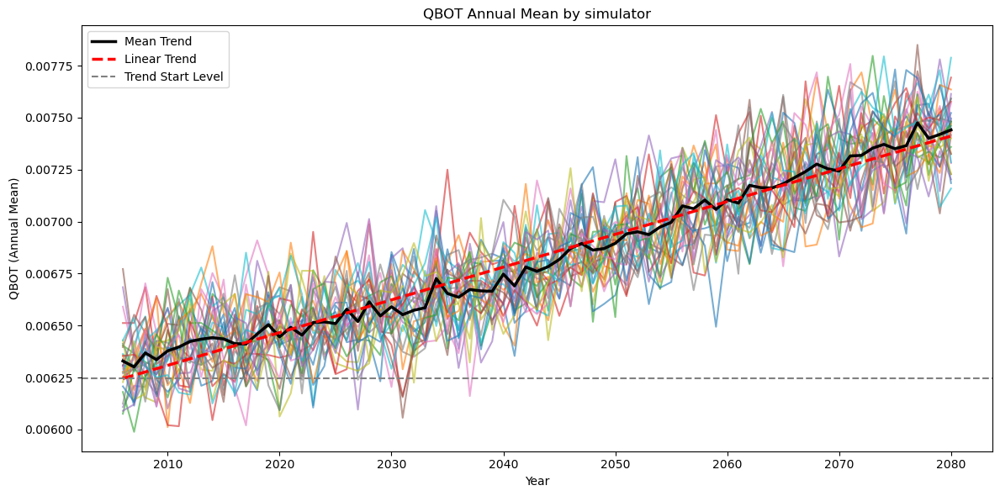

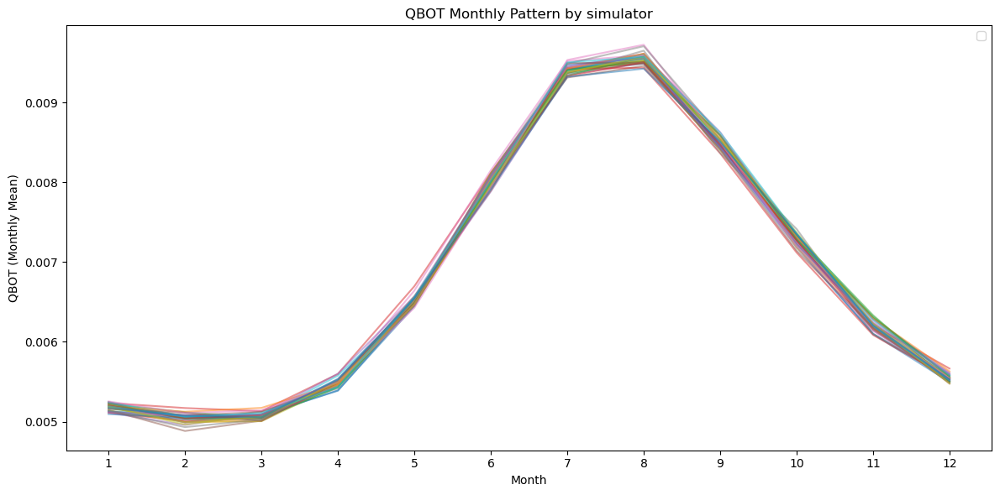

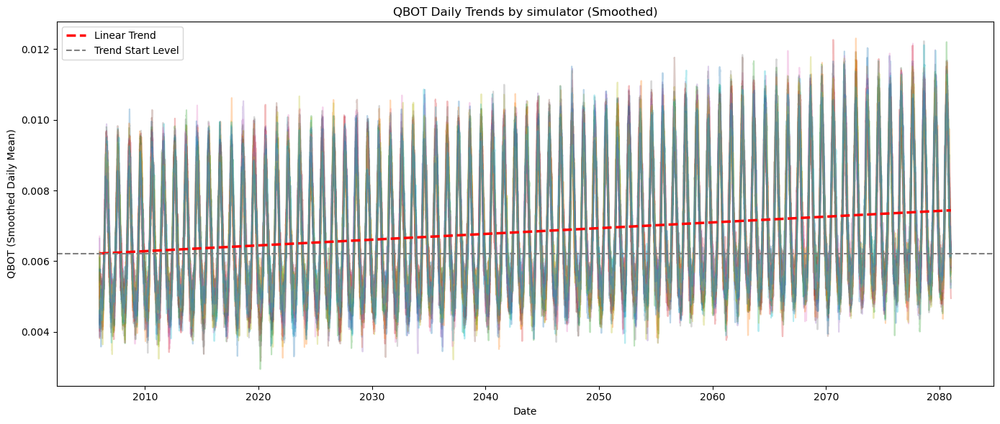

In [11]:
# Visualise Temporal Trends of `QBOT`
plot_variable_trends("QBOT",file_type="merged")

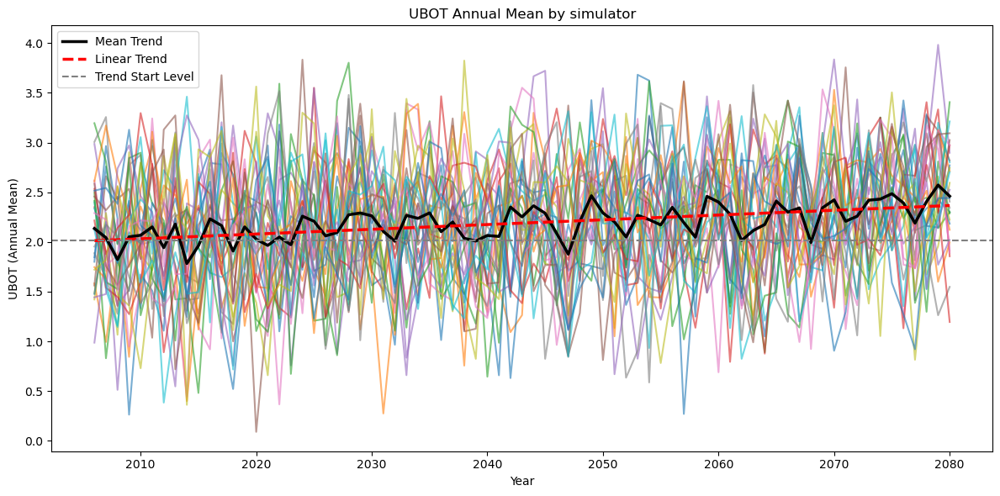

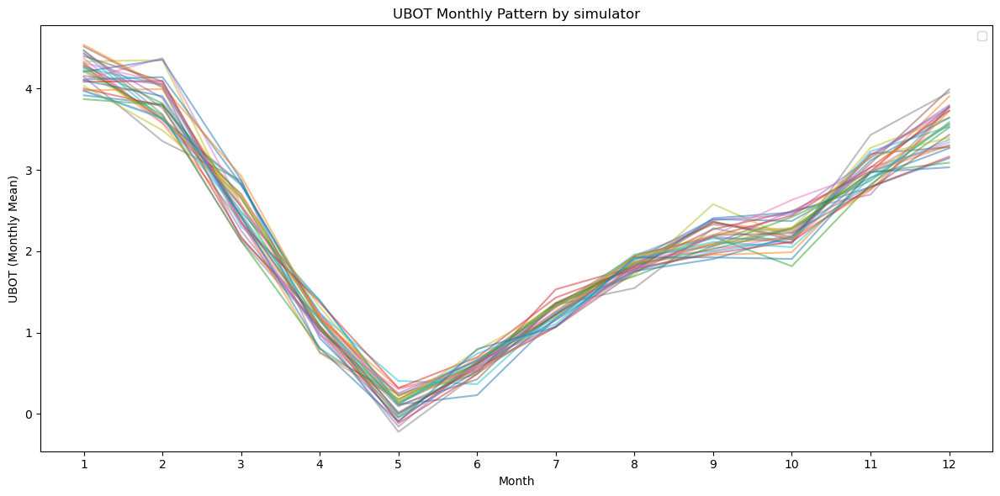

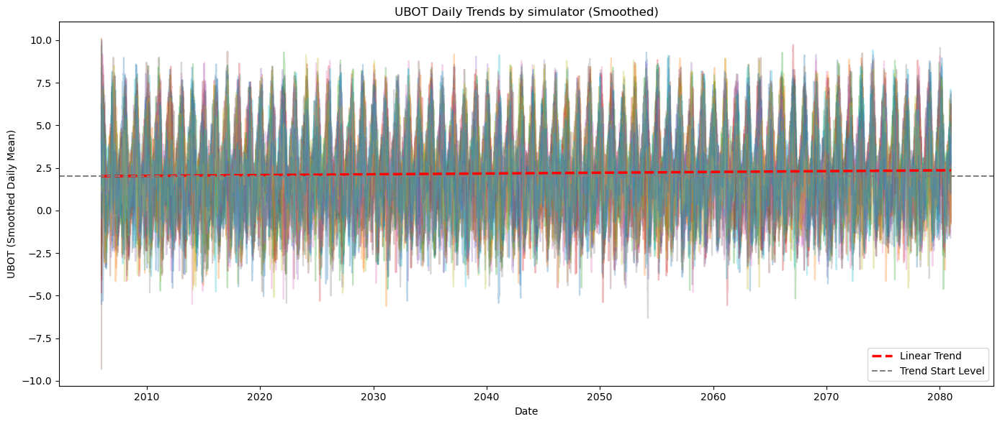

In [12]:
# Visualise Temporal Trends of `UBOT`
plot_variable_trends("UBOT",file_type="merged")

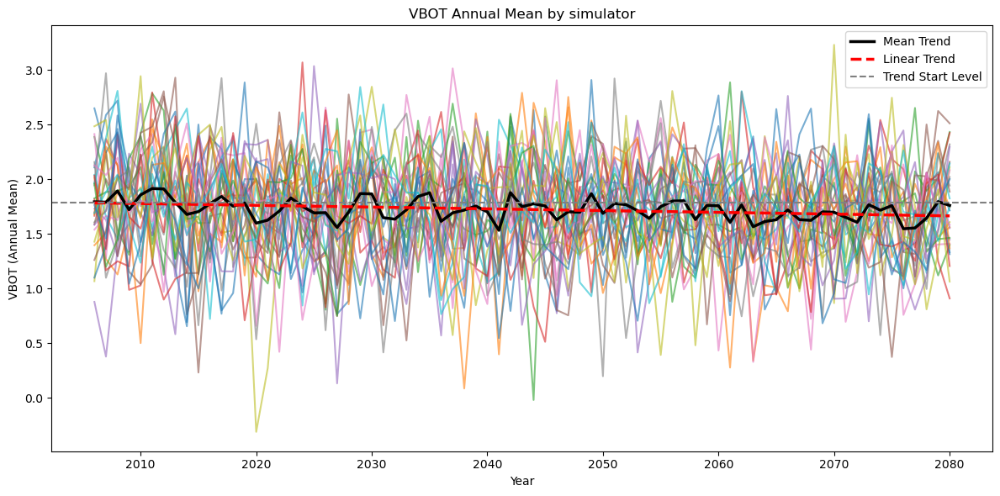

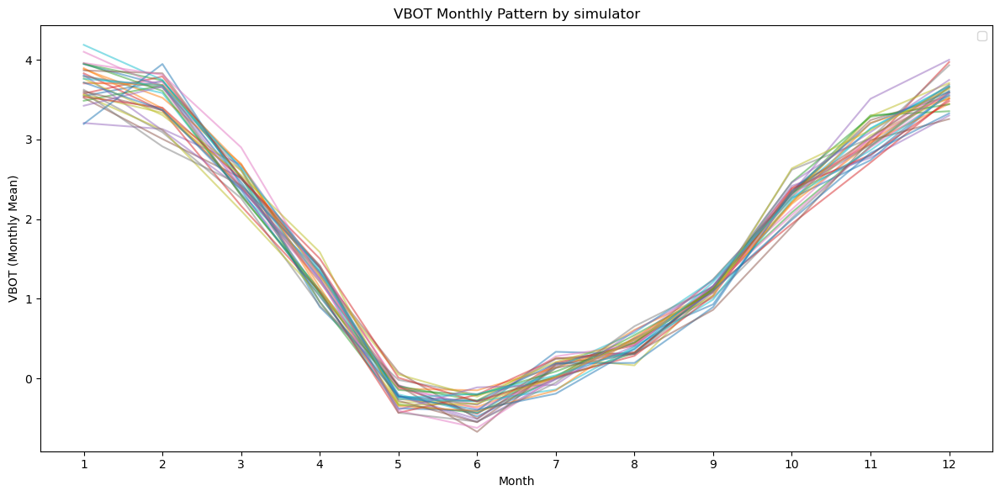

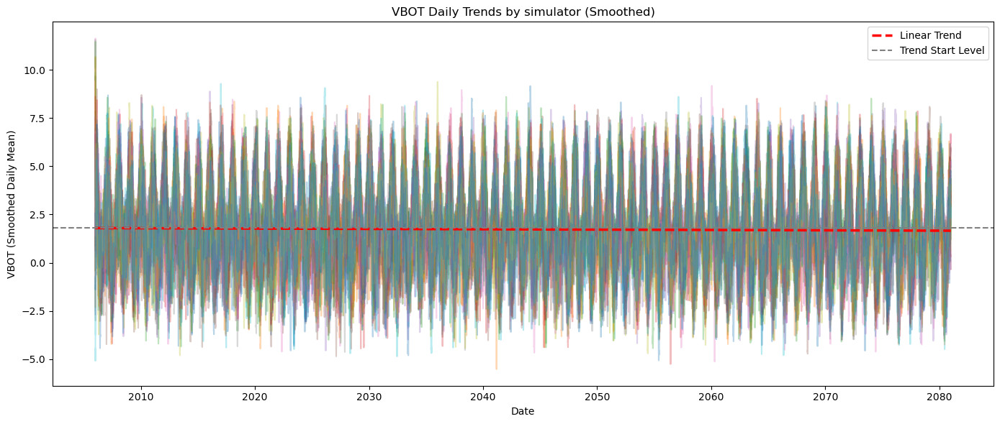

In [13]:
# Visualise Temporal Trends of `VBOT`
plot_variable_trends("VBOT",file_type="merged")

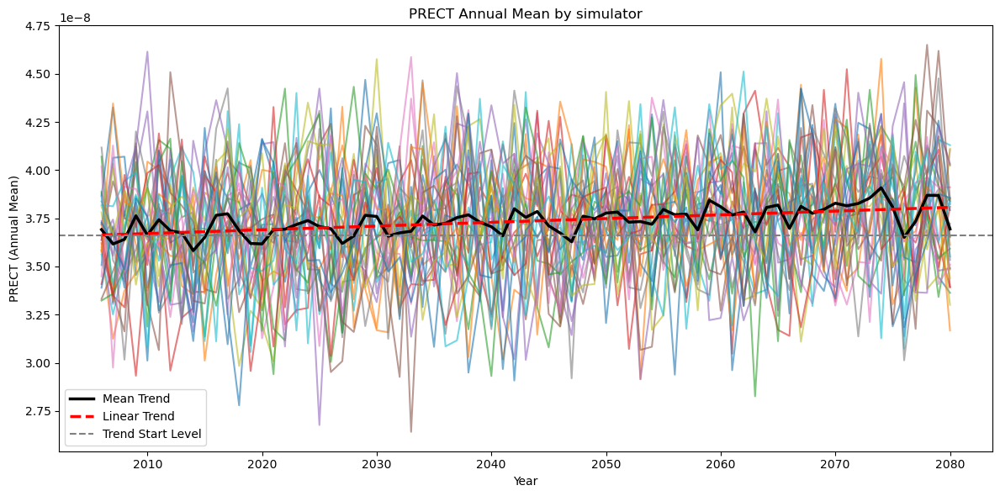

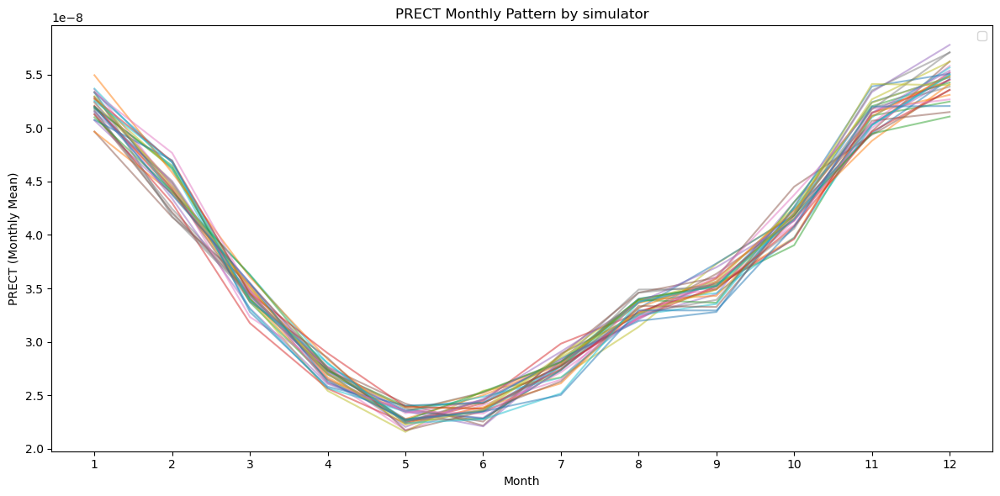

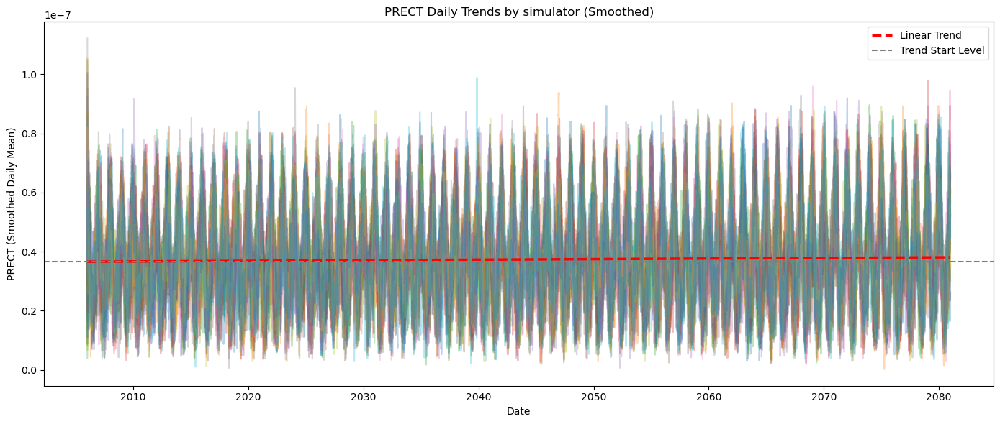

In [14]:
# Visualise Temporal Trends of `PRECT`
plot_variable_trends("PRECT",file_type="merged")

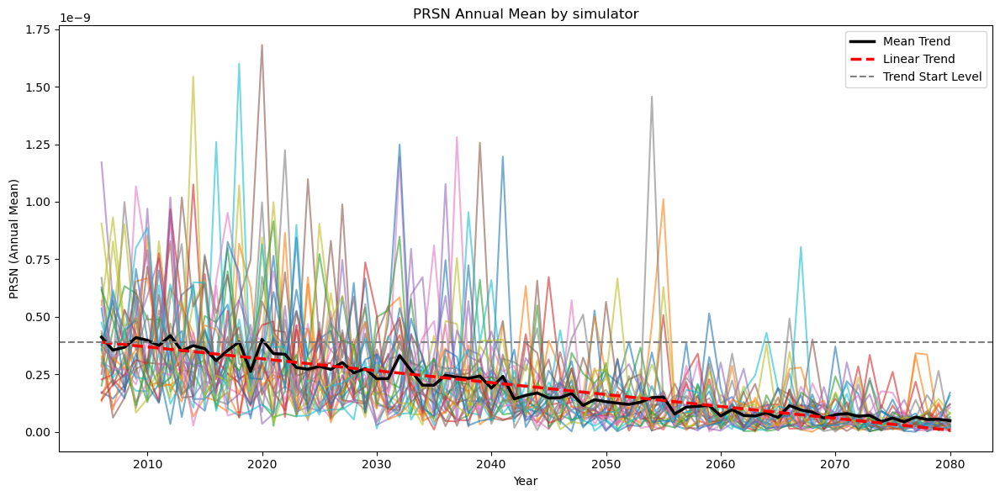

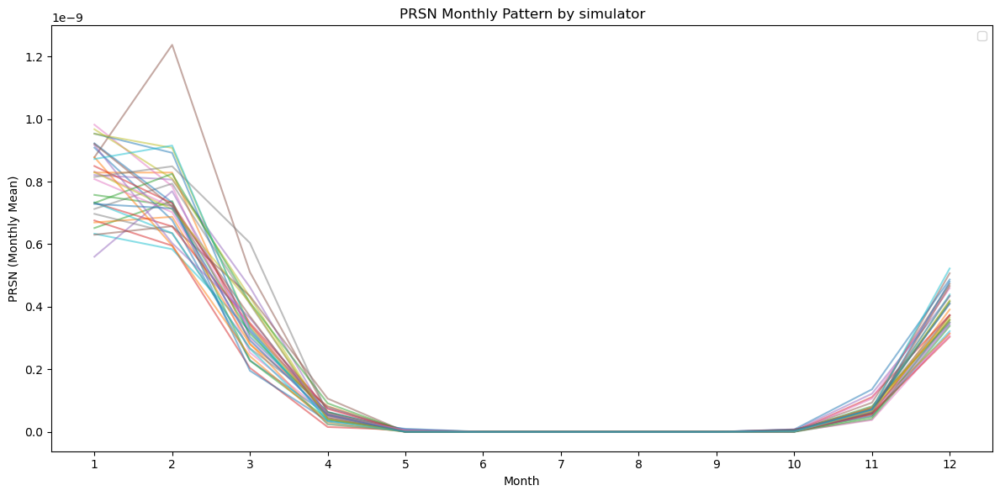

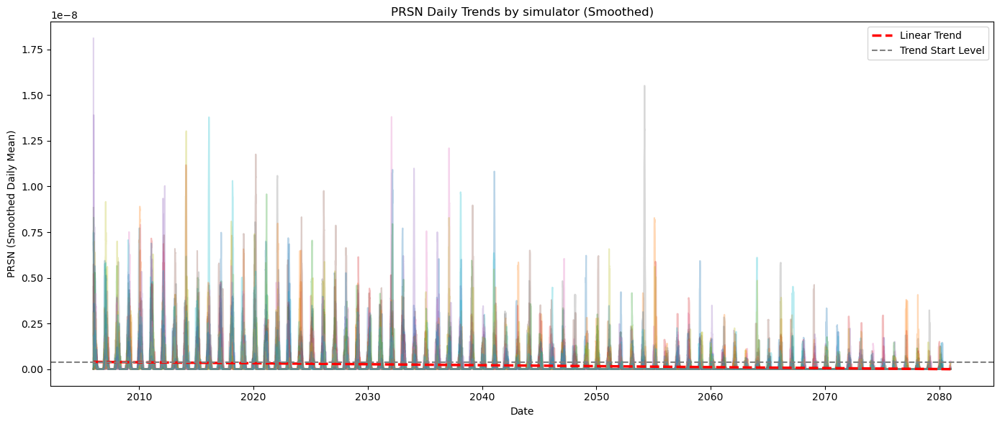

In [15]:
# Visualise Temporal Trends of `PRSN`
plot_variable_trends("PRSN",file_type="merged")

### Multivariate Analysis

#### Pairwise scatter plot

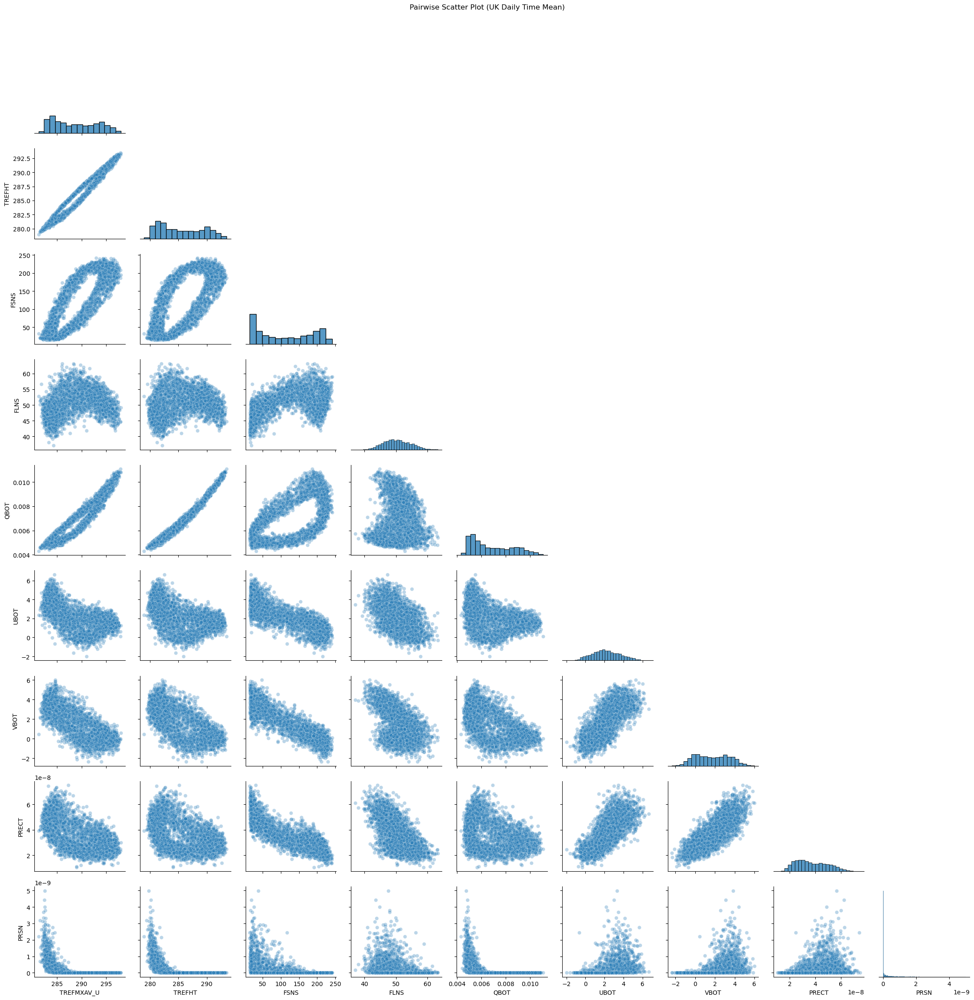

In [16]:
# Pairwise scatter plot of UK daily mean variables
# Load the UK daily mean dataset
ds = xr.open_dataset("Mean_time.nc")

# Convert to DataFrame
df = ds.to_dataframe().reset_index()

# Define the list of variables to analyze
var_list = [
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]

# Remove rows with missing values
plot_df = df[var_list].dropna()

# Downsample for faster plotting
plot_df = plot_df.sample(3000, random_state=42)

# Create pairwise scatter plot
sns.pairplot(plot_df, corner=True, plot_kws={'alpha': 0.3})
plt.suptitle("Pairwise Scatter Plot (UK Daily Time Mean)", y=1.02)
plt.tight_layout()
plt.show()

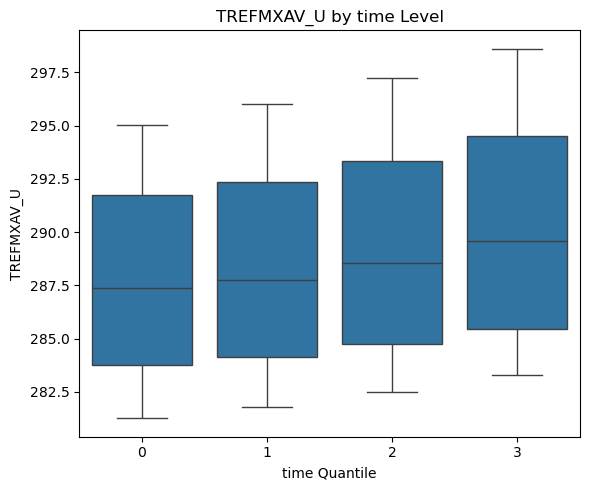

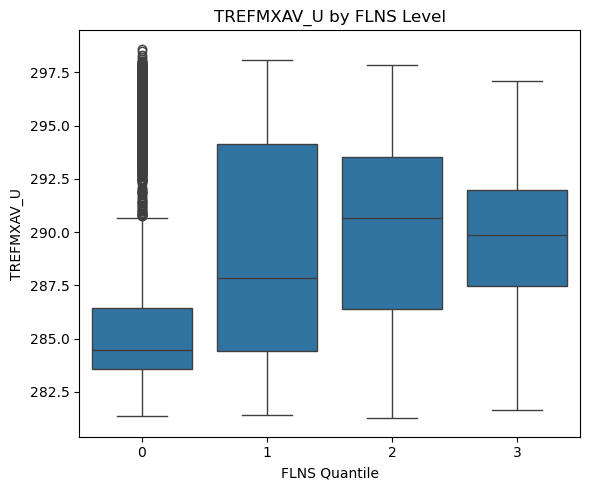

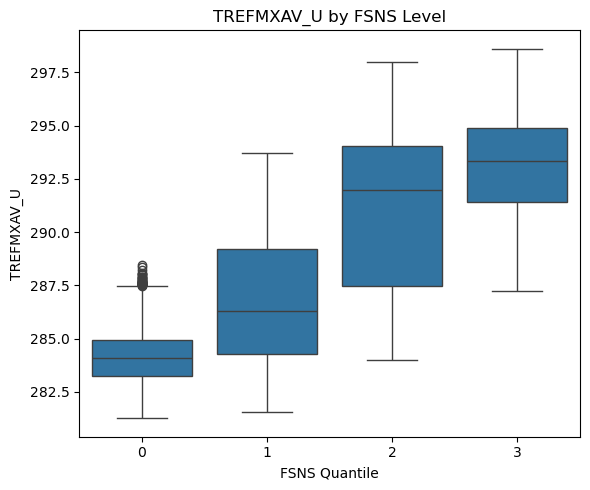

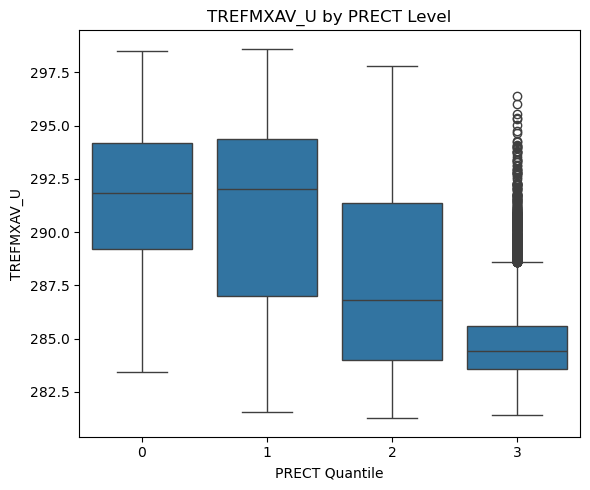

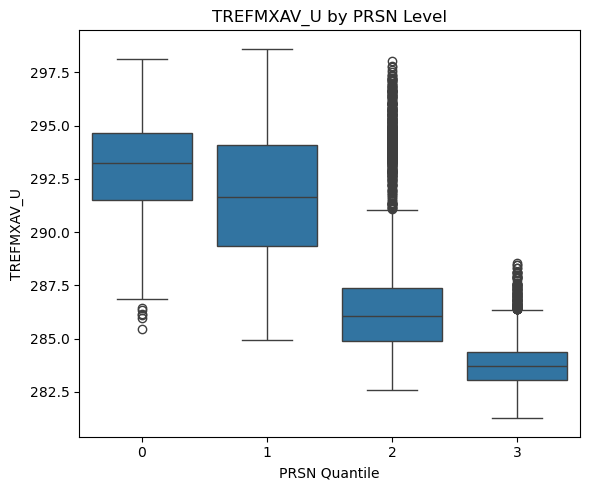

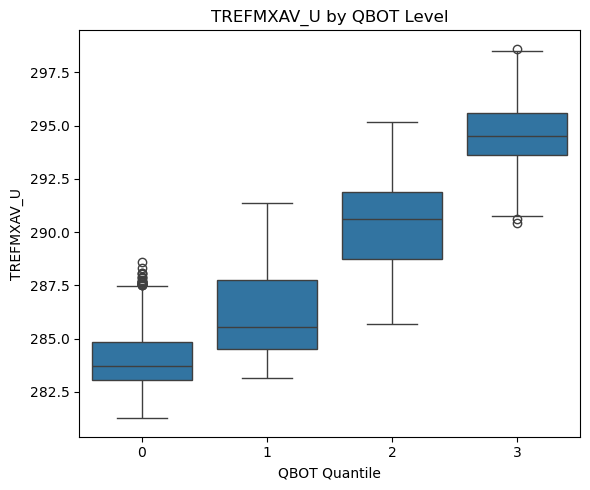

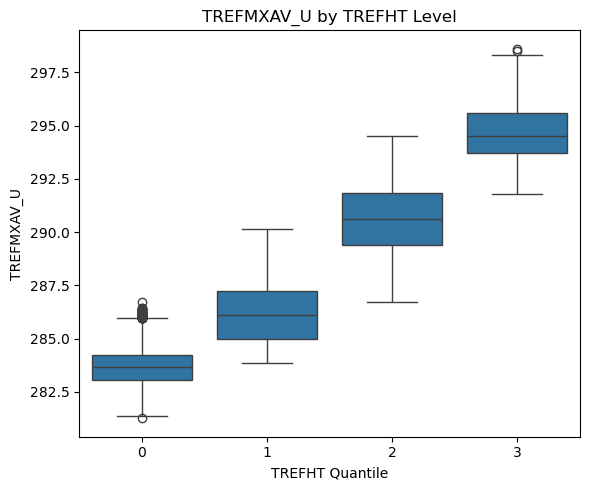

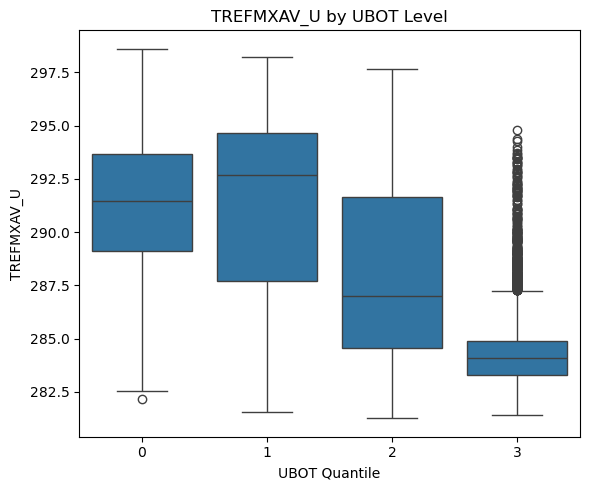

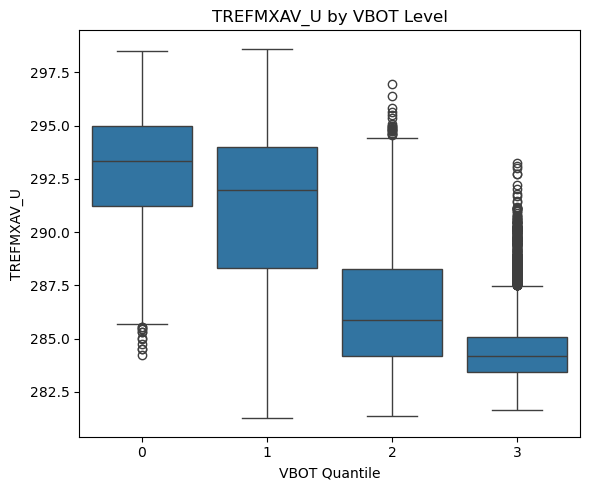

In [17]:
# Target variable for boxplots
target = "TREFMXAV_U"

# Select all feature variables except the target
variables = [col for col in df.columns if col != target]

# Loop through each variable and plot quantile-based boxplots
for var in variables:
    try:
        # Divide the variable into 4 quantile bins
        df[f"{var}_bin"] = pd.qcut(df[var], q=4, labels=False, duplicates="drop")
        
        # Plot the boxplot
        plt.figure(figsize=(6, 5))
        sns.boxplot(data=df, x=f"{var}_bin", y=target)
        plt.xlabel(f"{var} Quantile")
        plt.ylabel(f"{target}")
        plt.title(f"{target} by {var} Level")
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Skipped variable {var} due to error: {e}")

#### Correlation Matrix & VIF

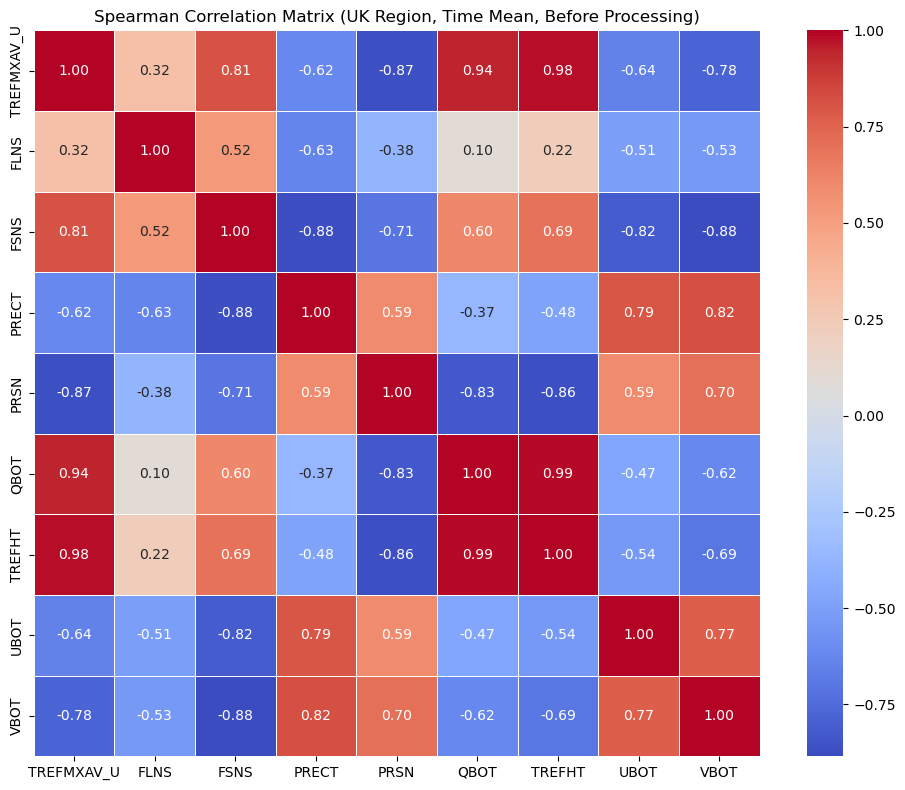

In [18]:
# Compute Spearman correlation

# Load UK-only time-mean dataset
ds = xr.open_dataset("Mean_time.nc")

# Convert to DataFrame
df = ds.to_dataframe().reset_index(drop=True)

# Remove time-related columns if present
df = df.drop(columns=[col for col in ['day', 'month', 'year'] if col in df.columns])

# Remove rows with missing values
df_clean = df.dropna()

# Compute Spearman correlation
corr = df_clean.corr(method='spearman')

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, fmt=".2f", cmap="coolwarm", square=True, linewidths=0.5)
plt.title("Spearman Correlation Matrix (UK Region, Time Mean, Before Processing)")
plt.tight_layout()
plt.show()

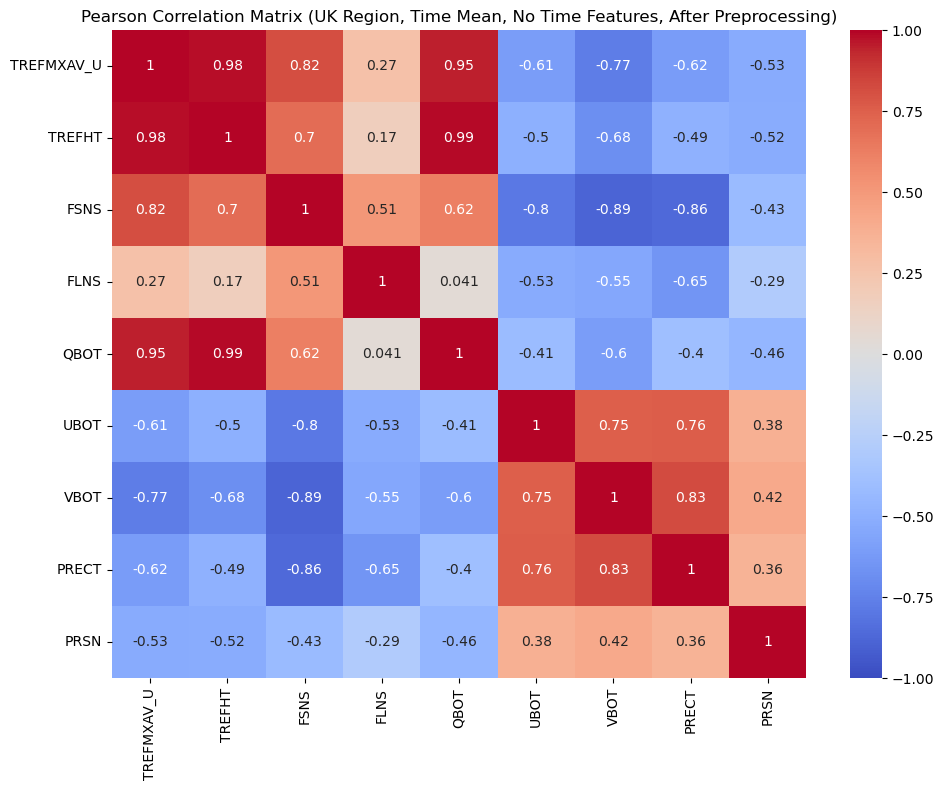

In [19]:
# Compute Pearson correlation matrix
pearson_corr = plot_df.corr(method='pearson')

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Pearson Correlation Matrix (UK Region, Time Mean, No Time Features, After Preprocessing)")
plt.tight_layout()
plt.show()


In [20]:
# Variance Inflation Factor (VIF) Analysis
# Load dataset and convert to DataFrame
ds = xr.open_dataset("Mean_time.nc")
df = ds.to_dataframe().reset_index()

# Select relevant variables and remove NaNs
features = [
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]
df = df[features].dropna()

# Define predictors by excluding the target variable
X = df.drop(columns="TREFMXAV_U") 

# Calculate VIF for each predictor
vif_data = pd.DataFrame()
vif_data["Variable"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

# Display VIF results
print(vif_data.sort_values("VIF", ascending=False))

  Variable         VIF
0   TREFHT  712.321835
2     FLNS  317.678526
3     QBOT   54.764450
6    PRECT   53.185035
1     FSNS   28.177890
5     VBOT   11.846683
4     UBOT   10.100292
7     PRSN    1.712490


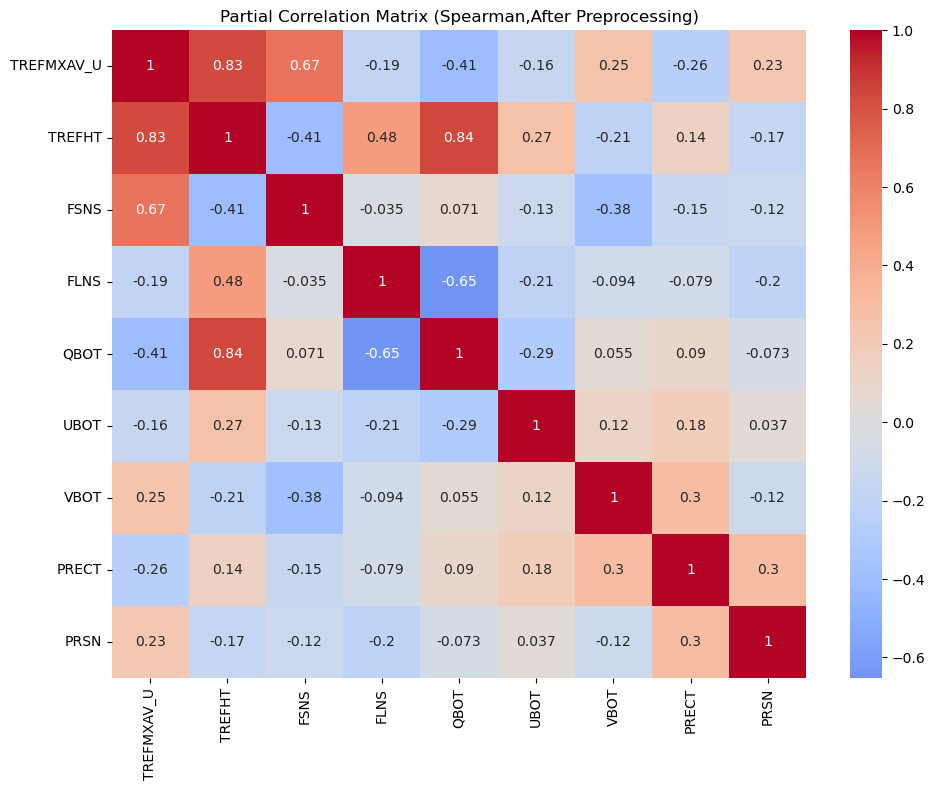

In [21]:
# Partial correlation analysis
features = df[[
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]].dropna()

#  Initialise an empty matrix for partial correlation coefficients
partial_corr_matrix = pd.DataFrame(index=features.columns, columns=features.columns)

# Compute partial correlation between each variable pair
for var1 in features.columns:
    for var2 in features.columns:
        if var1 == var2:
            partial_corr_matrix.loc[var1, var2] = 1.0
        else:
            covars = [v for v in features.columns if v not in [var1, var2]]
            r = pg.partial_corr(data=features, x=var1, y=var2, covar=covars, method='spearman')['r'].values[0]
            partial_corr_matrix.loc[var1, var2] = r

# Convert to numeric matrix
partial_corr_matrix = partial_corr_matrix.astype(float)

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(partial_corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Partial Correlation Matrix (Spearman,After Preprocessing)")
plt.tight_layout()
plt.show()


## 5.Data Preprocessing

### Visualise Spatial Pattern from a Single Simulator

Using 003_merged.nc as an example, plot the spatial distribution of temperature at the first time step, covering the full domain including the UK and its neighboring regions.

#### Plot full Spatial Pattern from Simulator 003

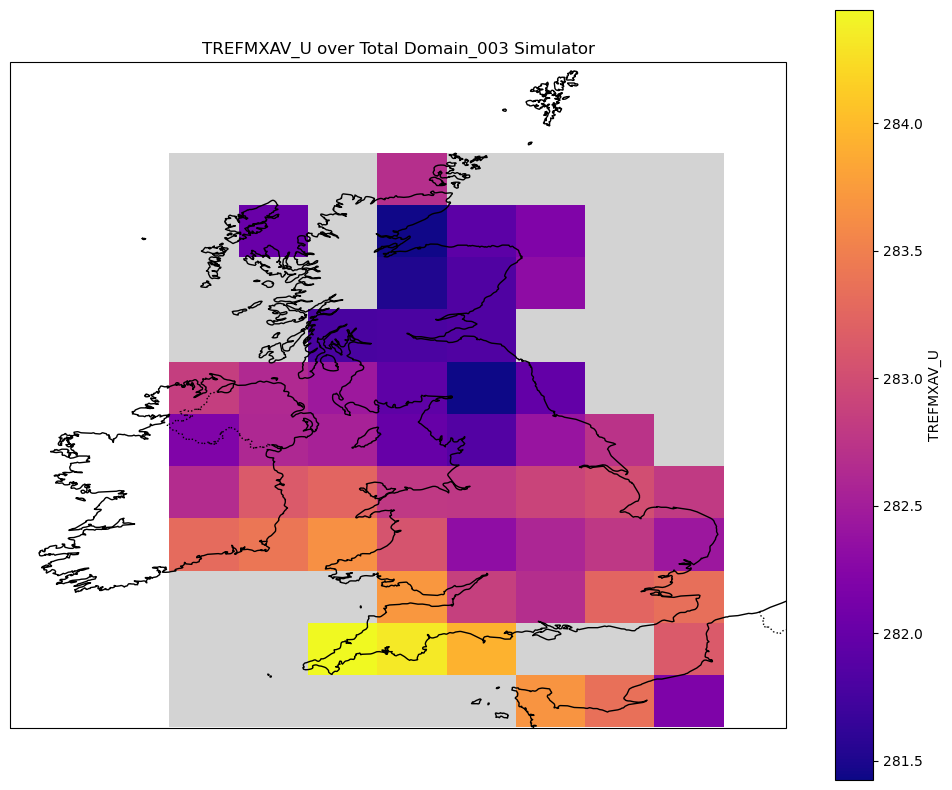

In [22]:
# Load the merged dataset
ds = xr.open_dataset("003_merged.nc", decode_times=False)

# Convert longitude to the range [-180, 180]
ds = convert_lon(ds)

# Select the first variable in the dataset and take the first time step
var = list(ds.data_vars)[0]
data = ds[var].isel(time=0)

# Prepare the grid for plotting
lon2d, lat2d, masked = prepare_plot_grid(data)

# Plot the spatial data
spatial_temp_plot(lon2d, lat2d, masked, var, f"{var} over Total Domain_003 Simulator")


#### Extract UK Mainland and Save as New .nc Files

Using 003_merged.nc as an example, plot the spatial distribution of temperature at the first time step, only covering the UK mainland.


In [ ]:
saved_paths = []

for path in files:
    # Load the dataset
    save1 = xr.open_dataset(path, decode_times=True)
    # Set coordinates for lat and lon
    save1 = save1.set_coords(["lat", "lon"])
    # Convert longitude to the range [-180, 180]
    save1 = convert_lon(save1)
    # Apply spatial mask to extract UK mainland only
    ds_uk = extract_uk_mainland(save1)

    mask = ~ds_uk["TREFMXAV_U"].isnull()  # Example variable to mask NaNs
    # Apply the mask to the dataset
    masked_vars = {}
    for var in ds_uk.data_vars:
        masked_vars[var] = ds_uk[var].where(mask)

    ds_masked = xr.Dataset(masked_vars, coords = ds_uk.coords)                           
    # Generate output file name and save
    outname = os.path.basename(path).replace("_merged.nc", "_UKonly.nc")
    ds_masked.to_netcdf(outname)
    saved_paths.append(outname)
    print(f"Saved to: {outname}")

Saved to: 003_UKonly.nc
Saved to: 004_UKonly.nc
Saved to: 005_UKonly.nc
Saved to: 006_UKonly.nc
Saved to: 007_UKonly.nc
Saved to: 008_UKonly.nc
Saved to: 009_UKonly.nc
Saved to: 010_UKonly.nc
Saved to: 011_UKonly.nc
Saved to: 012_UKonly.nc
Saved to: 013_UKonly.nc
Saved to: 014_UKonly.nc
Saved to: 015_UKonly.nc
Saved to: 016_UKonly.nc
Saved to: 017_UKonly.nc
Saved to: 018_UKonly.nc
Saved to: 019_UKonly.nc
Saved to: 020_UKonly.nc
Saved to: 021_UKonly.nc
Saved to: 022_UKonly.nc
Saved to: 023_UKonly.nc
Saved to: 024_UKonly.nc
Saved to: 025_UKonly.nc
Saved to: 026_UKonly.nc
Saved to: 027_UKonly.nc
Saved to: 028_UKonly.nc
Saved to: 029_UKonly.nc
Saved to: 030_UKonly.nc
Saved to: 031_UKonly.nc
Saved to: 032_UKonly.nc
Saved to: 033_UKonly.nc


In [24]:
# Preview the Extracted UK-only Dataset
# Show the dataset
df = xr.open_dataset("003_UKonly.nc", decode_times=True).to_dataframe().reset_index()

# Display the first 10 rows
print(df.head(10))

                  time        lat   lon  TREFMXAV_U       FLNS       FSNS  \
0  2006-01-02 00:00:00  50.418850 -7.50         NaN        NaN        NaN   
1  2006-01-02 00:00:00  50.418850 -6.25         NaN        NaN        NaN   
2  2006-01-02 00:00:00  50.418850 -5.00  284.443939  78.301247  44.980167   
3  2006-01-02 00:00:00  50.418850 -3.75  284.329865  82.156403  46.794003   
4  2006-01-02 00:00:00  50.418850 -2.50  283.929596  89.268539  47.019989   
5  2006-01-02 00:00:00  50.418850 -1.25         NaN  81.932076  45.881310   
6  2006-01-02 00:00:00  50.418850  0.00         NaN  68.962288  44.376884   
7  2006-01-02 00:00:00  50.418850  1.25  283.128845  61.798542  42.044857   
8  2006-01-02 00:00:00  51.361256 -7.50         NaN        NaN        NaN   
9  2006-01-02 00:00:00  51.361256 -6.25         NaN        NaN        NaN   

          PRECT          PRSN      QBOT      TREFHT      UBOT      VBOT  
0           NaN           NaN       NaN         NaN       NaN       NaN  
1   

#### Plot UK-only Spatial Pattern from Simulator 003

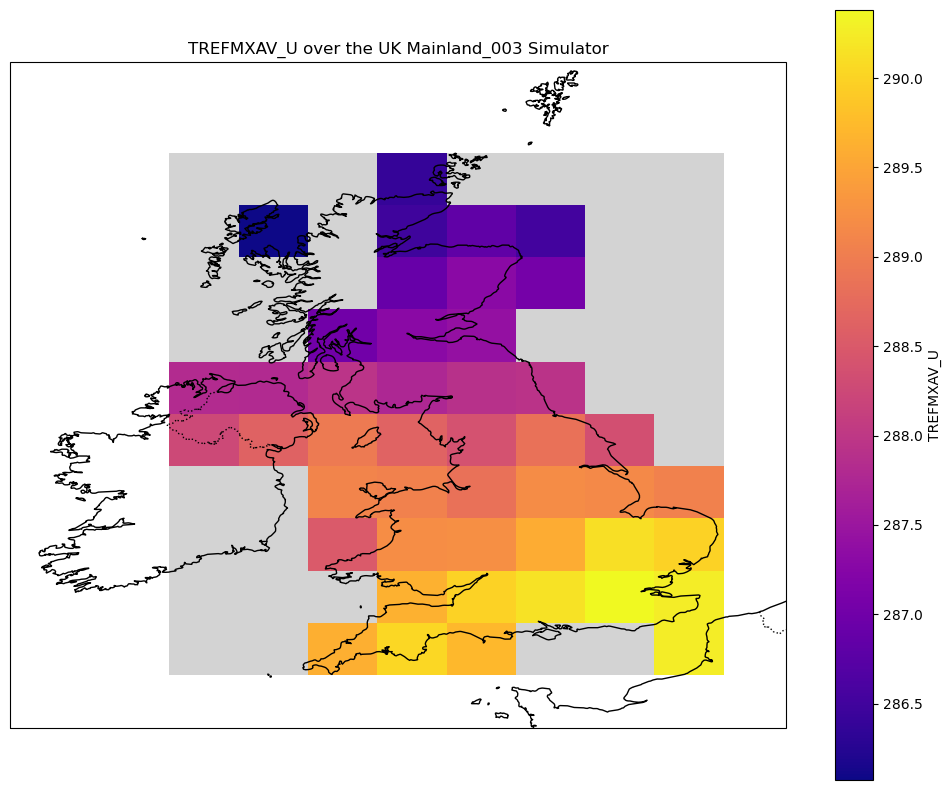

In [25]:
# Load the UK-only dataset
ds1 = xr.open_dataset("003_UKonly.nc", decode_times=False)

# Select the main variable
var1 = list(ds1.data_vars)[0]
data1 = ds1[var1]

# Convert to DataFrame
df1 = data1.to_dataframe().reset_index()

# Prepare the grid for plotting
grid1 = df1.pivot_table(index="lat", columns="lon", values=var1)

# Generate 2D grid and mask NaN values
lat = grid1.index.values
lon = grid1.columns.values
lon2d1, lat2d1 = np.meshgrid(lon, lat)
masked1 = np.ma.masked_invalid(grid1.values)

# Plotting the UK-only data
spatial_temp_plot(lon2d1, lat2d1, masked1, var1, f"{var1} over the UK Mainland_003 Simulator",)


#### Compare Original Grid Points vs UK-Selected Grid Points

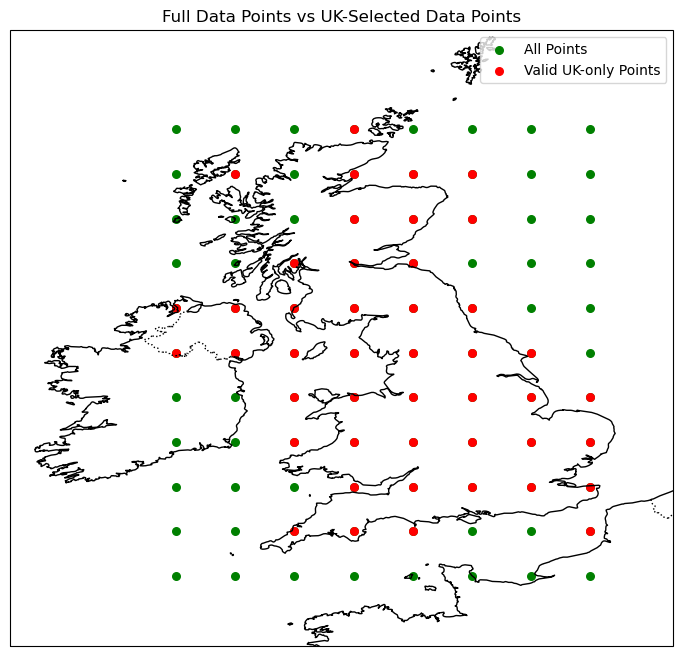

In [26]:
# Extract all original grid points (from merged dataset) 
all_points = ds[['lat', 'lon']].to_dataframe().drop_duplicates().reset_index()[['lat', 'lon']]

# Extract valid points from the UK-only dataset
valid_mask = ~ds1[var].isel(time=0).isnull()
lat_vals = ds1['lat'].values
lon_vals = ds1['lon'].values
lat_grid, lon_grid = np.meshgrid(lat_vals, lon_vals, indexing='ij')

# Extract coordinates where data is valid
valid_lats = lat_grid[valid_mask.values]
valid_lons = lon_grid[valid_mask.values]
valid_points = pd.DataFrame({'lat': valid_lats, 'lon': valid_lons})

# Plotting
data_distribution_plot(all_points, valid_points, title="Full Data Points vs UK-Selected Data Points")


### Visualise Spatial Pattern from a mean file

#### Plot full Spatial Pattern

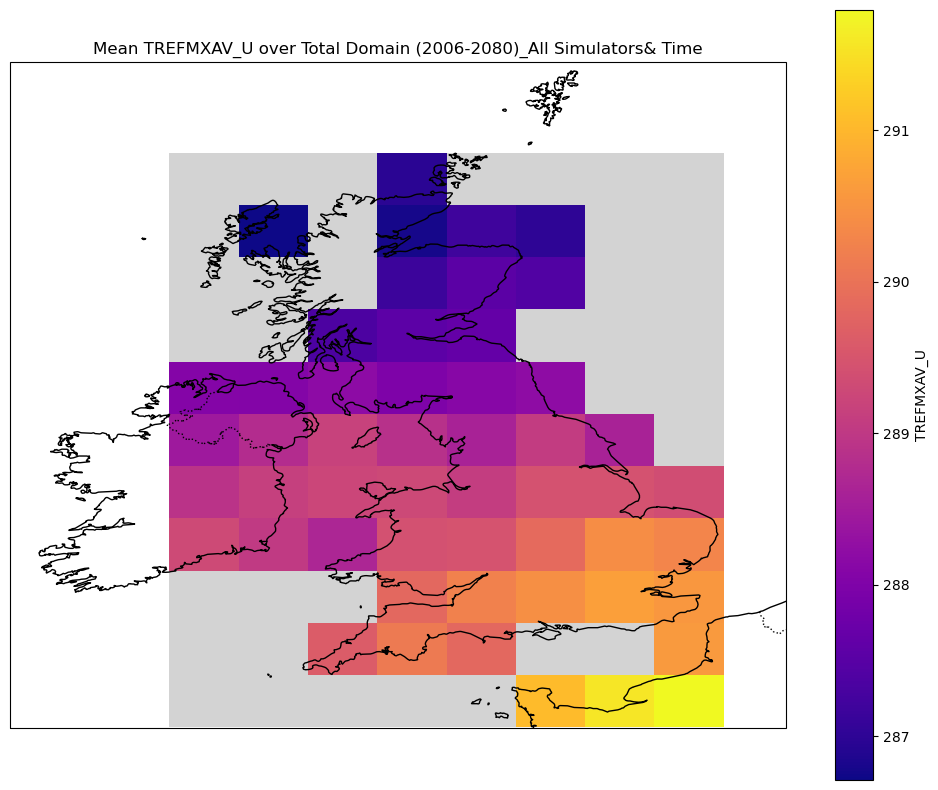

In [27]:
# Load the mean temperature dataset
ds2 = xr.open_dataset("Mean_spatial.nc", decode_times=False)

# Convert longitude to -180 to 180
ds2 = convert_lon(ds2)

# Select the variable to plot
var2 = list(ds2.data_vars)[0]
data2 = ds2[var2]  # this is already (lat, lon)

# Prepare the grid for plotting
lon2d2, lat2d2, masked2 = prepare_plot_grid(data2)

# Plot
spatial_temp_plot(lon2d2, lat2d2, masked2, var2, f"Mean {var2} over Total Domain (2006-2080)_All Simulators& Time")

#### Plot UK-only Spatial Pattern

In [28]:
# Apply the same UK mainland mask to the spatial mean dataset
ds_meanUK = extract_uk_mainland(ds2)
# Save the UK-only dataset
ds_meanUK.to_netcdf("Mean_spatial_onlyUK.nc")
print("Saved：Mean_spatial_onlyUK.nc")

Saved：Mean_spatial_onlyUK.nc


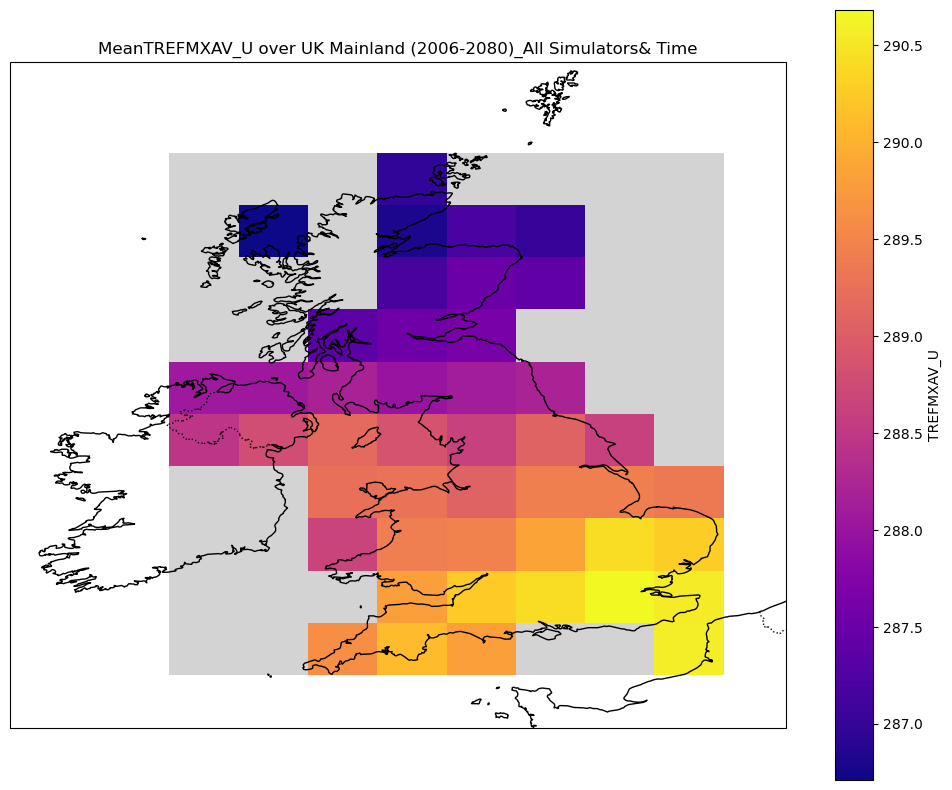

In [29]:
# Load the UK-only dataset
ds3 = xr.open_dataset("Mean_spatial_onlyUK.nc", decode_times=False)

# Choose the variable to plot
var3 = list(ds3.data_vars)[0]
data3 = ds3[var3]

# prepare grid for plotting
lon2d3, lat2d3, masked3 = prepare_plot_grid(data3)

# Plotting the UK-only data
spatial_temp_plot(lon2d3, lat2d3, masked3, var3, f"Mean{var} over UK Mainland (2006-2080)_All Simulators& Time")


#### Compare Original Grid Points vs UK-Selected Grid Points

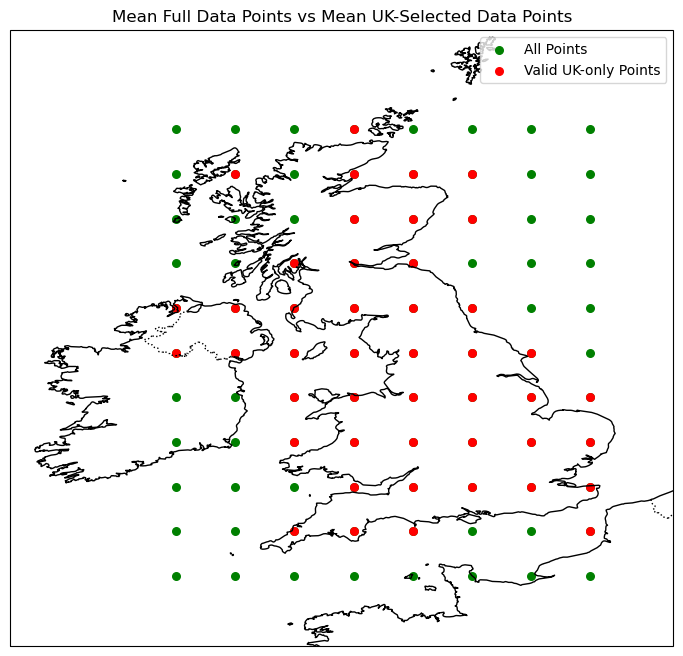

In [30]:
# Extract all original grid points (from merged dataset) 
all_points = ds2[['lat', 'lon']].to_dataframe().drop_duplicates().reset_index()[['lat', 'lon']]

# Extract valid points from the UK-only dataset
valid_mask = ~ds3[var3].isnull()
lat_vals = ds3['lat'].values
lon_vals = ds3['lon'].values
lat_grid, lon_grid = np.meshgrid(lat_vals, lon_vals, indexing='ij')

# Extract coordinates where data is valid
valid_lats = lat_grid[valid_mask.values]
valid_lons = lon_grid[valid_mask.values]
valid_points = pd.DataFrame({'lat': valid_lats, 'lon': valid_lons})

# Plotting
data_distribution_plot(all_points, valid_points, title="Mean Full Data Points vs Mean UK-Selected Data Points")

### Decompose the 'time' variable in UK-only files  

In [31]:
# Find all _UKonly.nc files
uk_files = sorted(glob.glob("*_UKonly.nc"))

for path in uk_files:
    ds = xr.open_dataset(path, decode_times=True)

    # Skip datasets without time dimension
    if 'time' not in ds.coords:
        print(f"Skipped: {path} — no 'time' coordinate.")
        continue

    # Add year/month/day as new coordinate dimensions
    ds = ds.assign_coords(
        year=("time", ds.time.dt.year.data),
        month=("time", ds.time.dt.month.data),
        day=("time", ds.time.dt.day.data)
    )

    # Save to a new file with "_with_ymd" suffix
    outname = path.replace("_UKonly.nc", "_UKonly_with_ymd.nc")
    ds.to_netcdf(outname)
    print(f"Saved: {outname}")


Saved: 003_UKonly_with_ymd.nc
Saved: 004_UKonly_with_ymd.nc
Saved: 005_UKonly_with_ymd.nc
Saved: 006_UKonly_with_ymd.nc
Saved: 007_UKonly_with_ymd.nc
Saved: 008_UKonly_with_ymd.nc
Saved: 009_UKonly_with_ymd.nc
Saved: 010_UKonly_with_ymd.nc
Saved: 011_UKonly_with_ymd.nc
Saved: 012_UKonly_with_ymd.nc
Saved: 013_UKonly_with_ymd.nc
Saved: 014_UKonly_with_ymd.nc
Saved: 015_UKonly_with_ymd.nc
Saved: 016_UKonly_with_ymd.nc
Saved: 017_UKonly_with_ymd.nc
Saved: 018_UKonly_with_ymd.nc
Saved: 019_UKonly_with_ymd.nc
Saved: 020_UKonly_with_ymd.nc
Saved: 021_UKonly_with_ymd.nc
Saved: 022_UKonly_with_ymd.nc
Saved: 023_UKonly_with_ymd.nc
Saved: 024_UKonly_with_ymd.nc
Saved: 025_UKonly_with_ymd.nc
Saved: 026_UKonly_with_ymd.nc
Saved: 027_UKonly_with_ymd.nc
Saved: 028_UKonly_with_ymd.nc
Saved: 029_UKonly_with_ymd.nc
Saved: 030_UKonly_with_ymd.nc
Saved: 031_UKonly_with_ymd.nc
Saved: 032_UKonly_with_ymd.nc
Saved: 033_UKonly_with_ymd.nc


### Compute Time Mean for UK-only files

In [32]:
# Find all nc files
files_UKonly = sorted(glob.glob("*_UKonly_with_ymd.nc"))

# List all variable names
data_vars = list(xr.open_dataset(files_UKonly[0]).data_vars)

# Containers to store results
time_means_UKonly = {}

# Process each variable
for var in data_vars:
    var_list = []
    for f in files_UKonly:
        ds = xr.open_dataset(f, decode_times=False)
        var_list.append(ds[var])
    # Combine along a new 'sim' dimension-> (sim, time, lat, lon)
    combined = xr.concat(var_list, dim="sim") 
    # # Compute time series mean across simulators and space
    time_mean = combined.mean(dim=["sim", "lat", "lon"], skipna=True)
    # Store result
    time_means_UKonly[var] = time_mean
# Save new dataset
xr.Dataset(time_means_UKonly).to_netcdf("Mean_time_UK_only.nc")
print(" Saved:Mean_time_UK_only.nc")

 Saved:Mean_time_UK_only.nc


## Univariate analysis

### Temporal Trend Plots

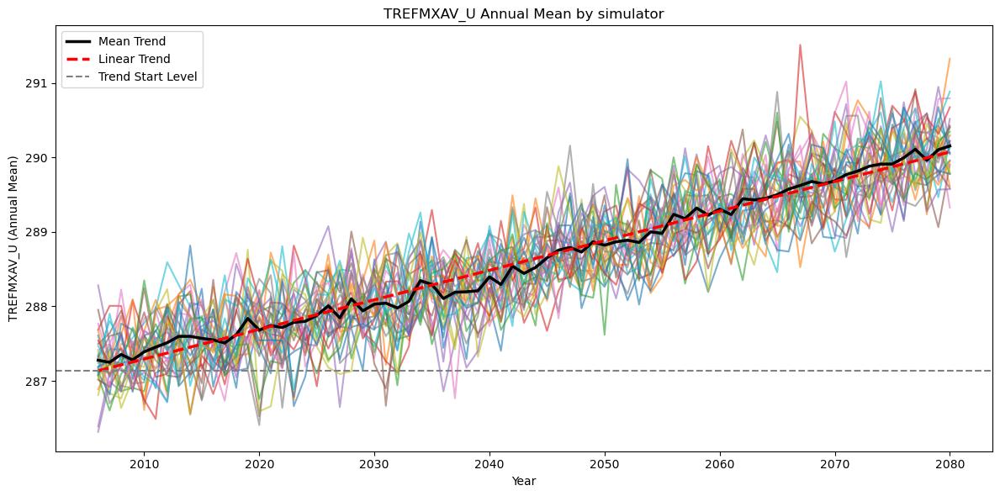

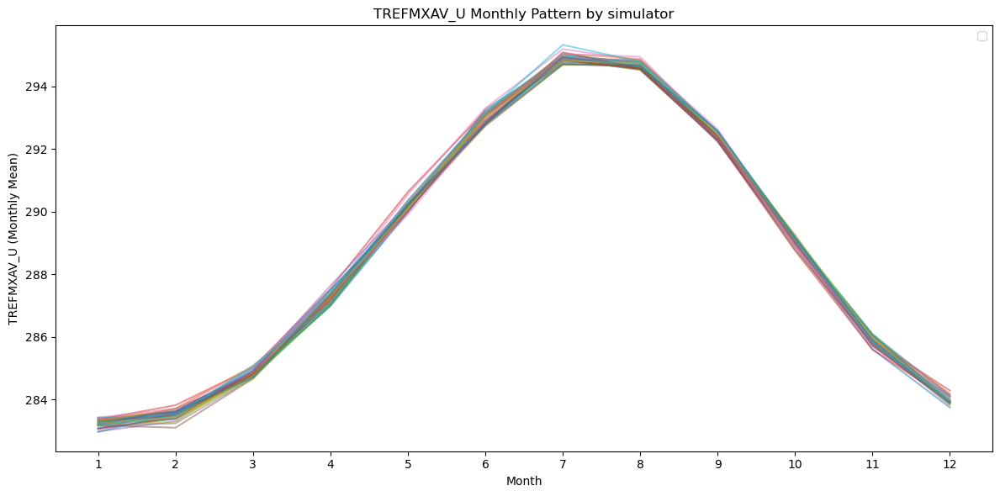

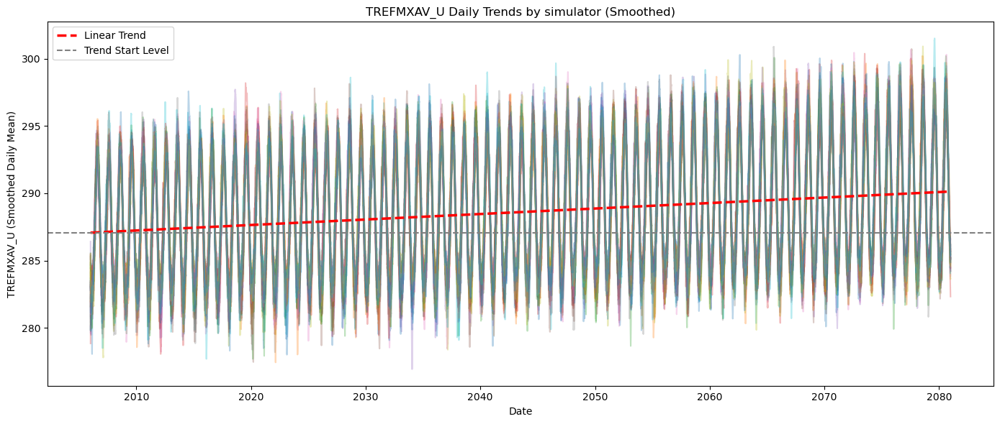

In [33]:
# Visualise Temporal Trends of `TREFMXAV_U`
plot_variable_trends("TREFMXAV_U",file_type="UKonly")

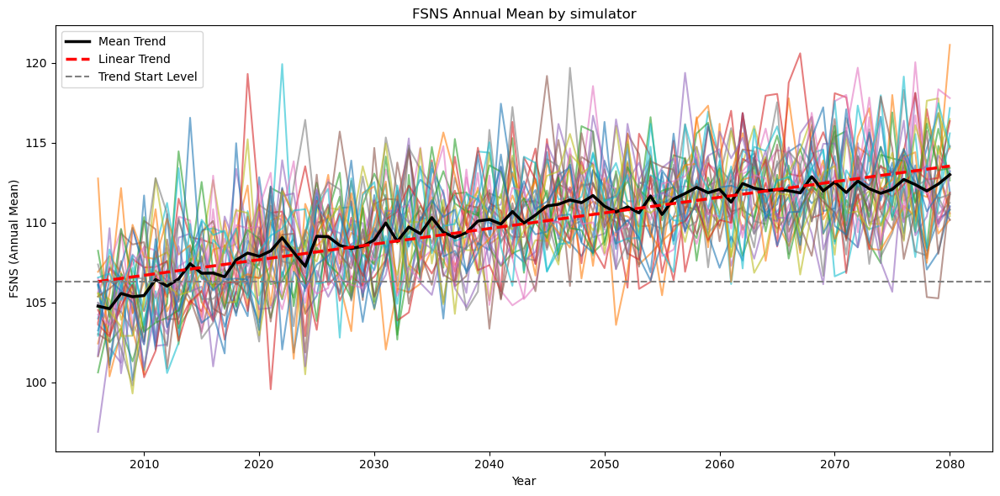

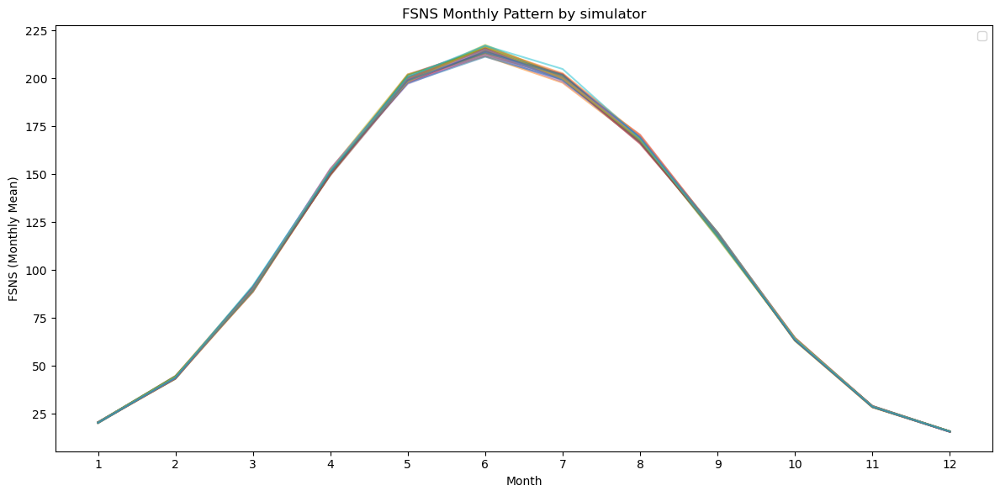

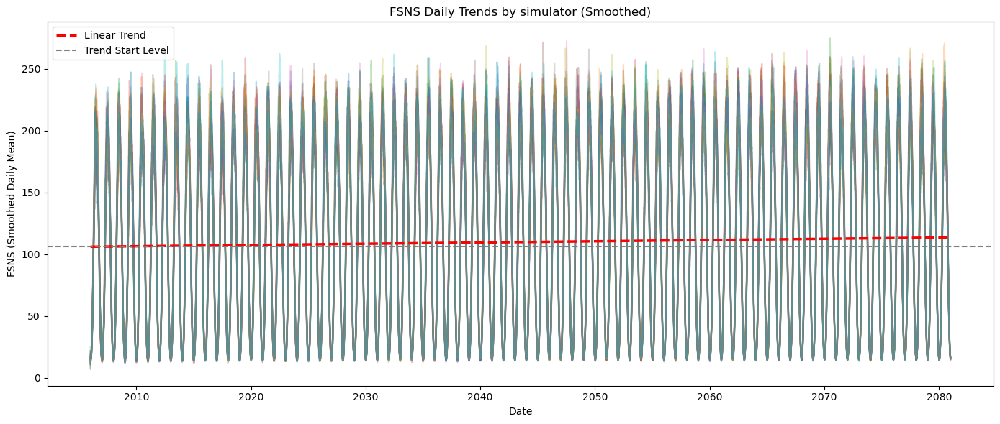

In [34]:
# Visualise Temporal Trends of `FSNS`
plot_variable_trends("FSNS",file_type="UKonly")

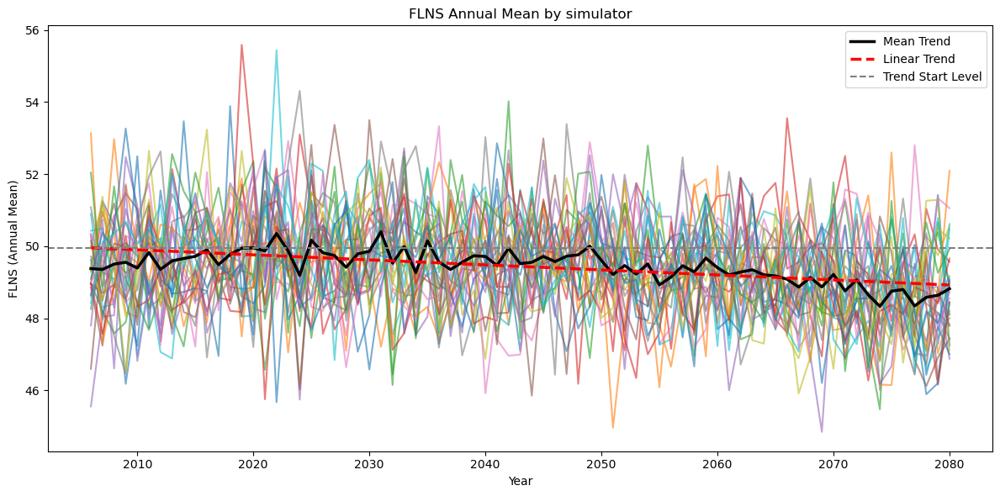

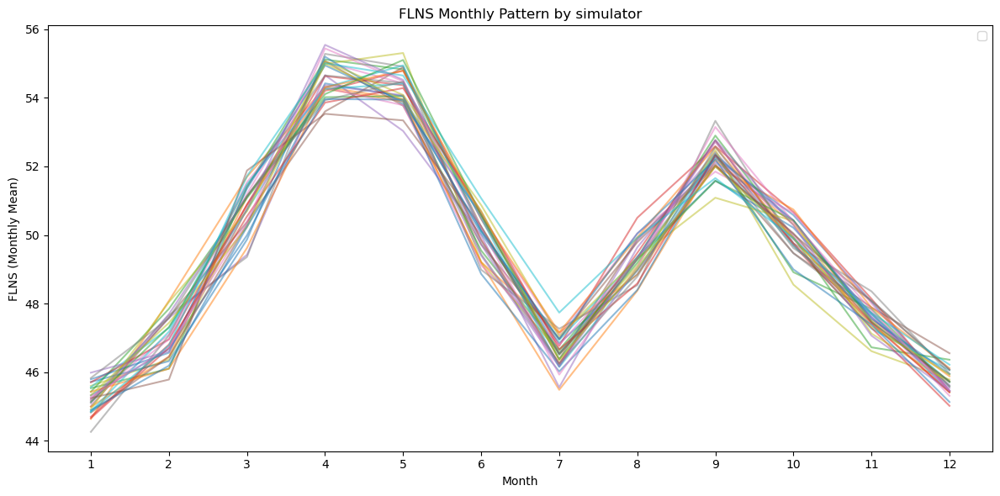

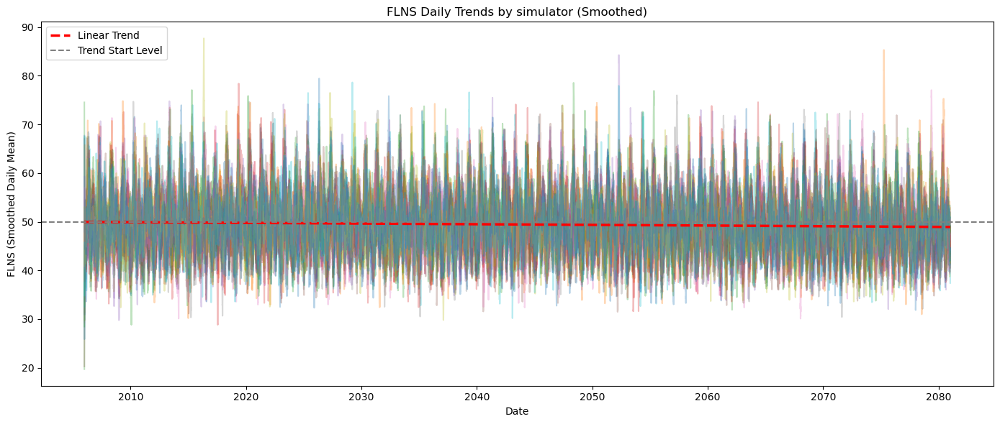

In [35]:
# Visualise Temporal Trends of `FLNS`
plot_variable_trends("FLNS",file_type="UKonly")

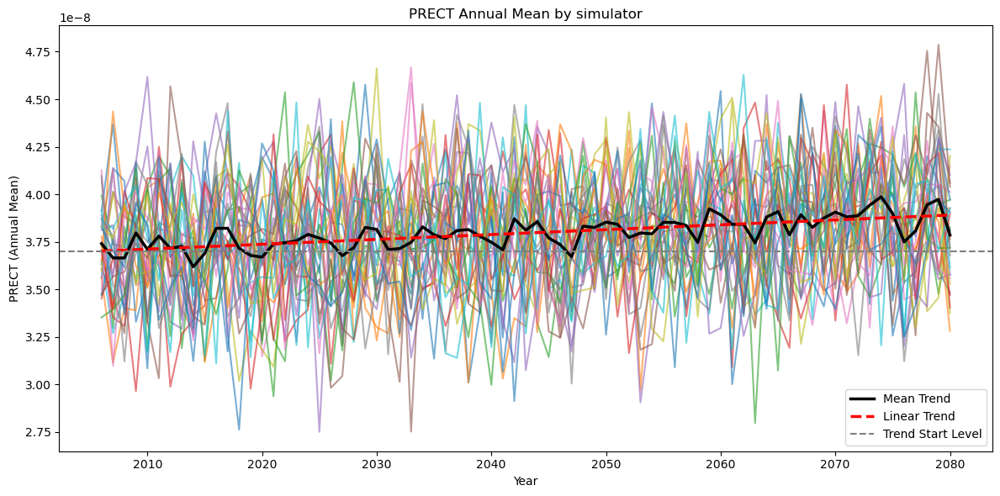

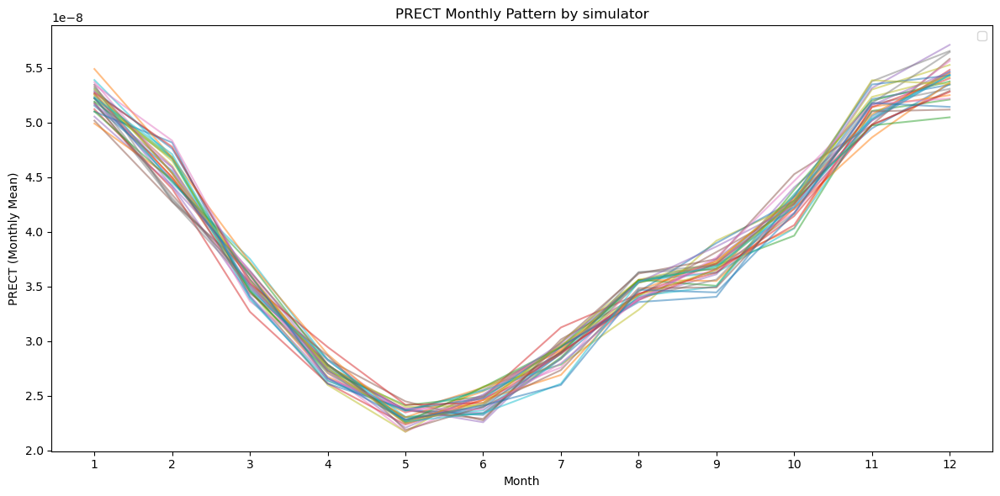

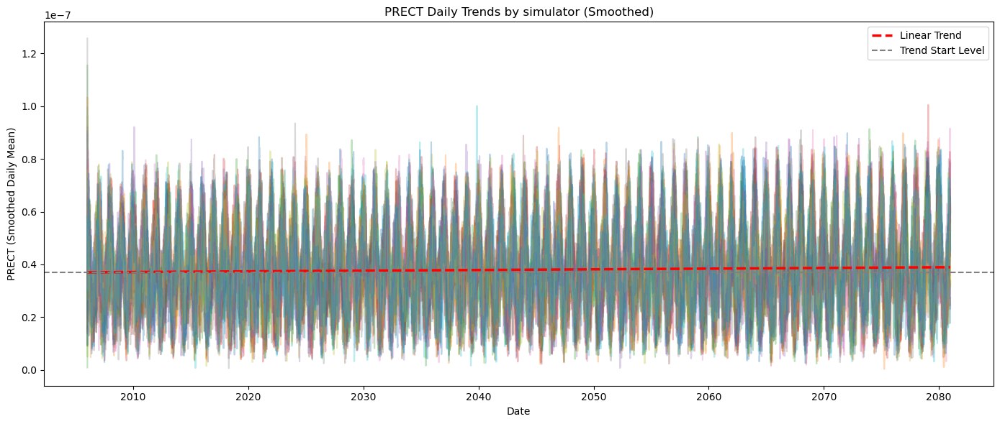

In [36]:
# Visualise Temporal Trends of `PRECT`
plot_variable_trends("PRECT",file_type="UKonly")

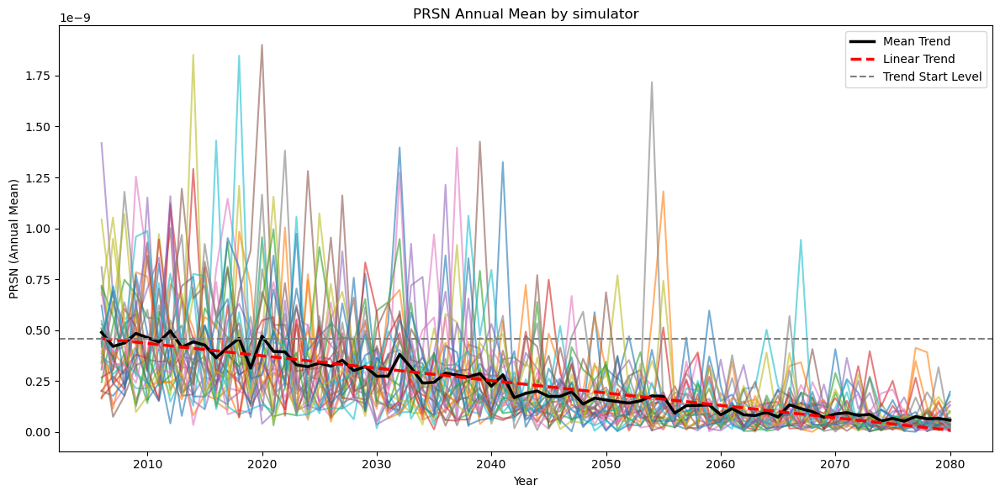

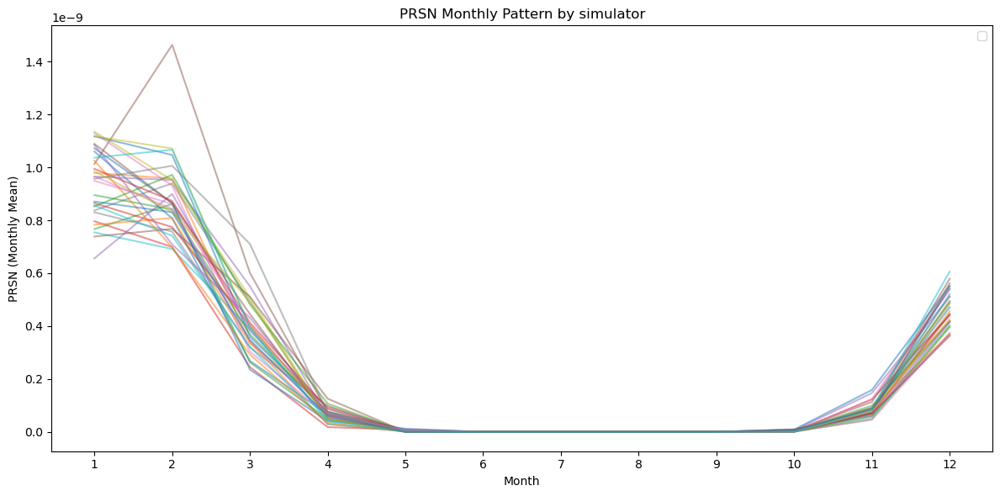

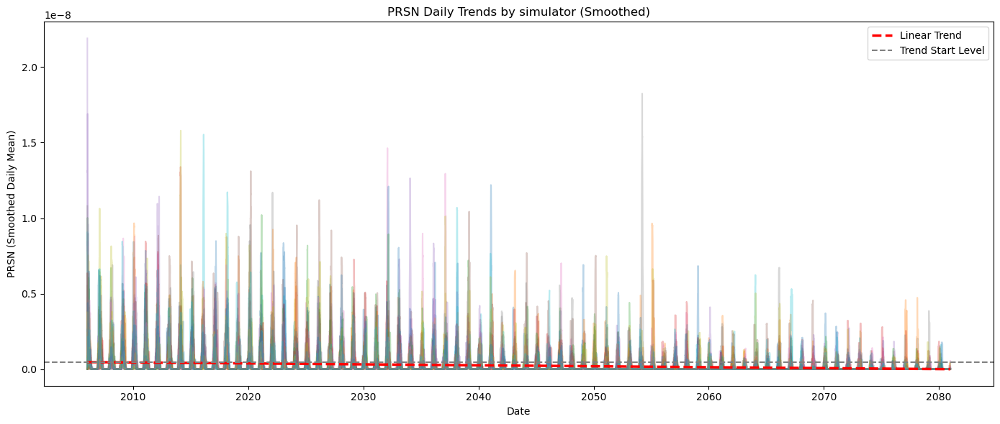

In [37]:
# Visualise Temporal Trends of `PRSN`
plot_variable_trends("PRSN",file_type="UKonly")

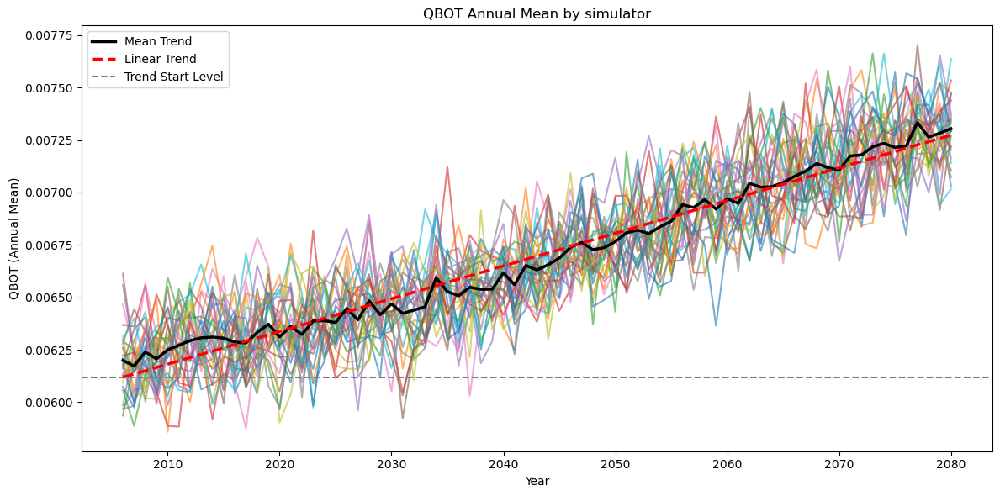

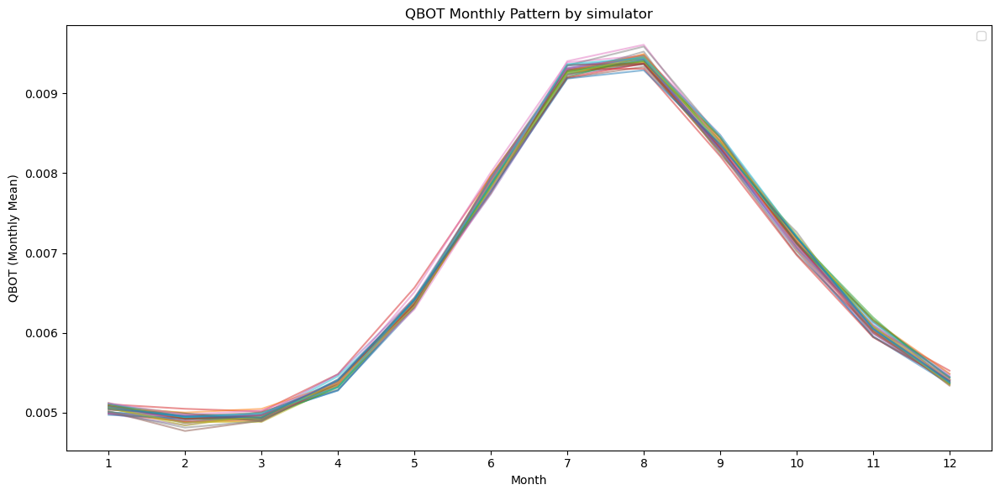

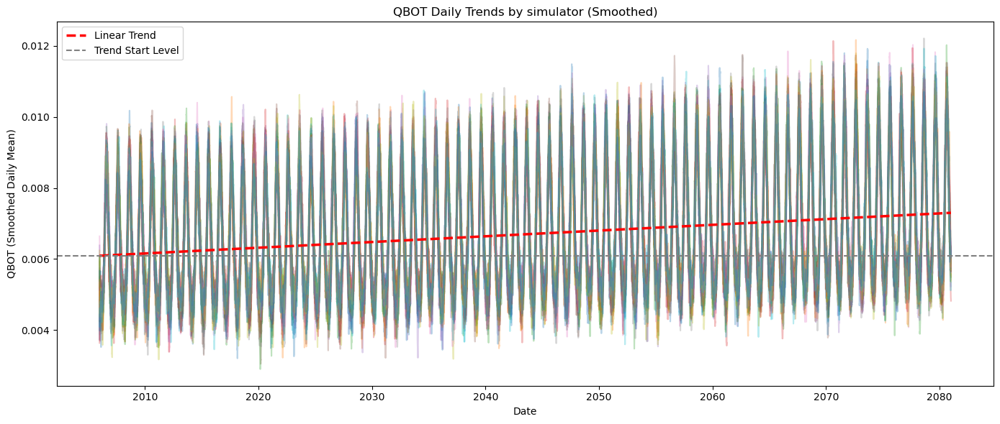

In [38]:
# Visualise Temporal Trends of `QBOT`
plot_variable_trends("QBOT",file_type="UKonly")

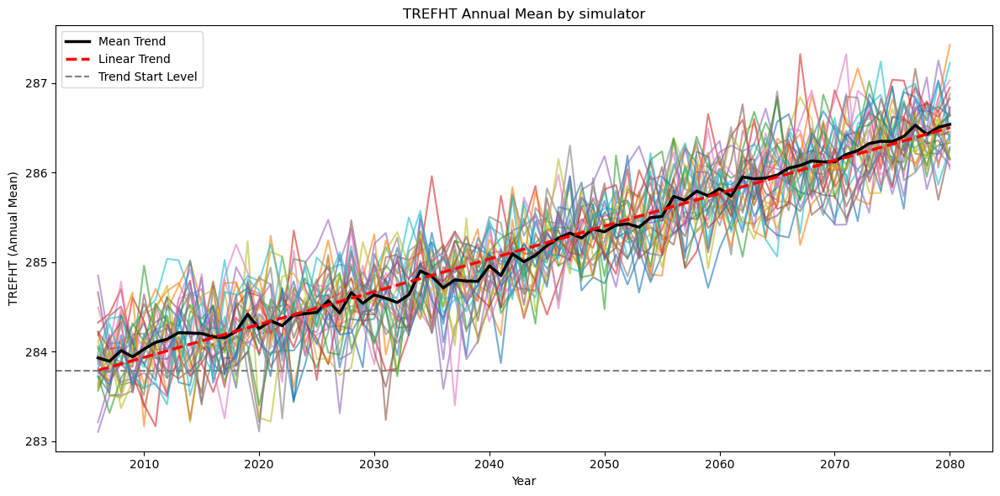

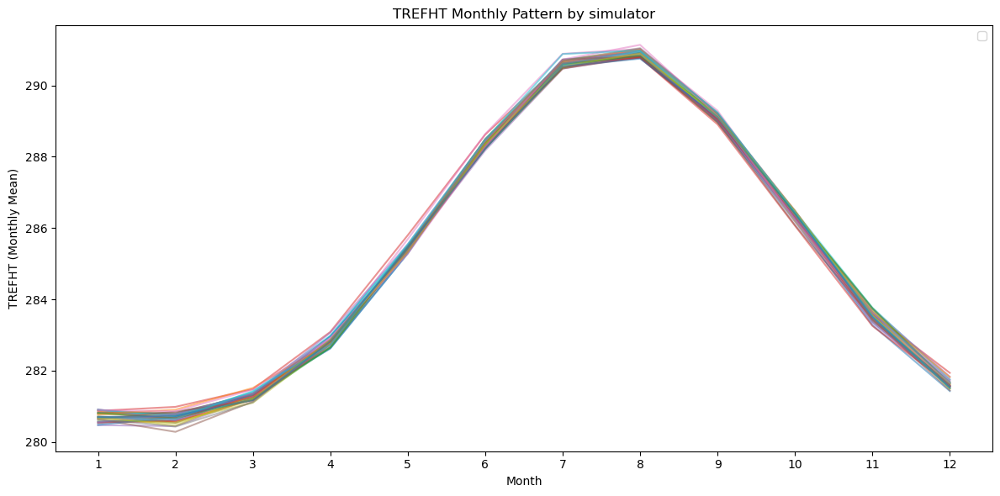

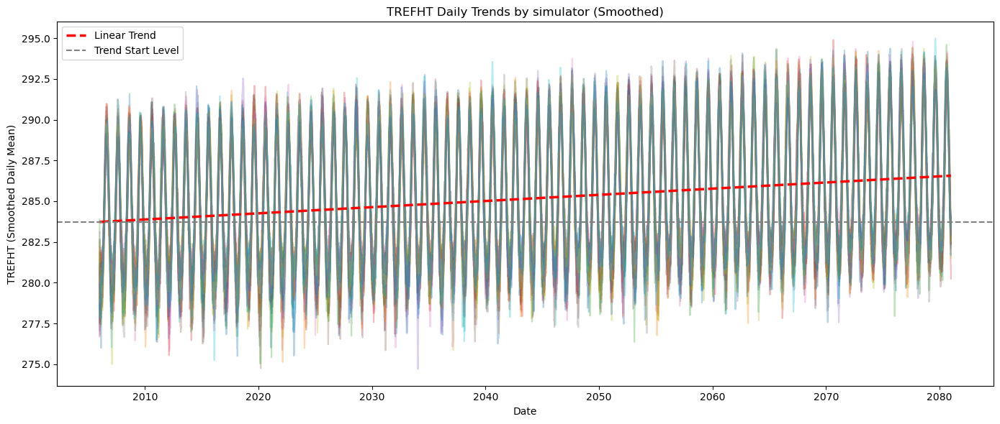

In [39]:
# Visualise Temporal Trends of `TREFHT`
plot_variable_trends("TREFHT",file_type="UKonly")

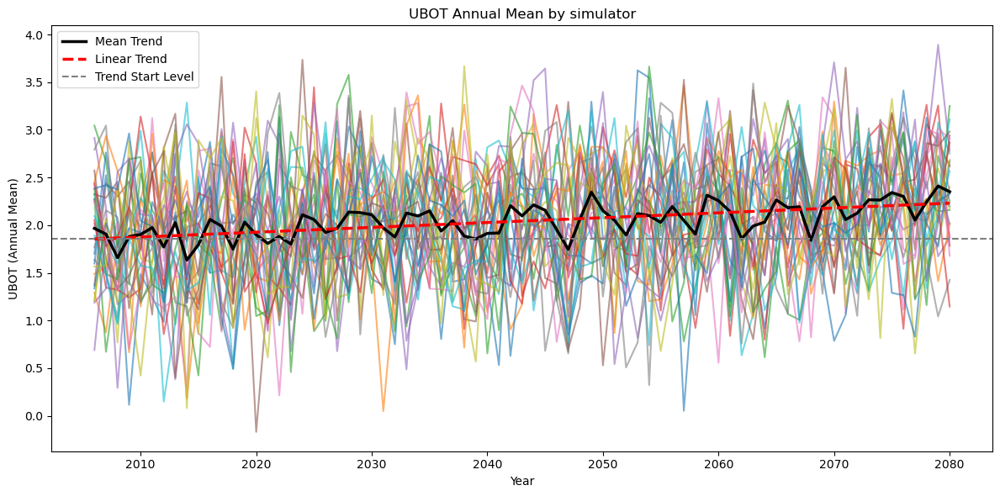

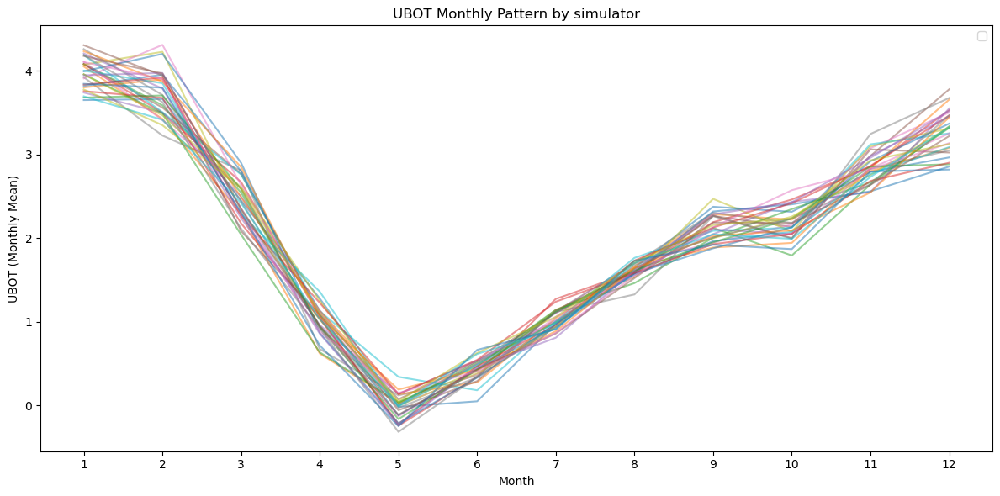

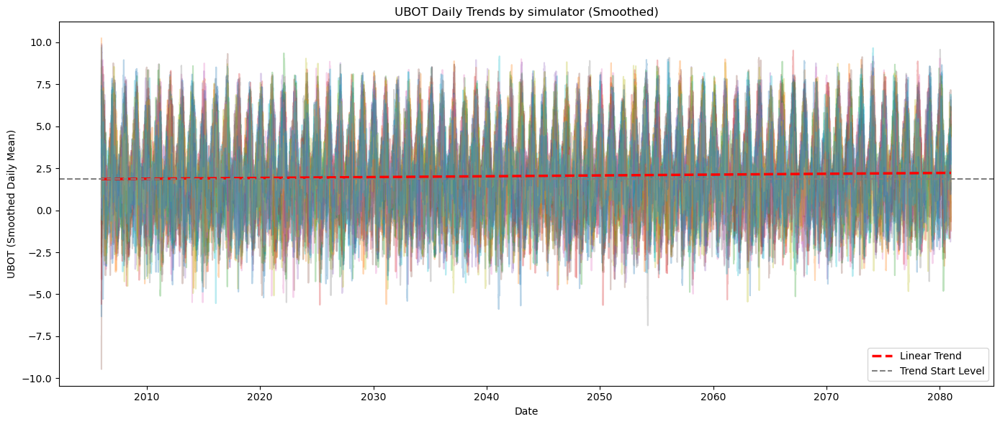

In [40]:
# Visualise Temporal Trends of `UBOT`
plot_variable_trends("UBOT",file_type="UKonly")

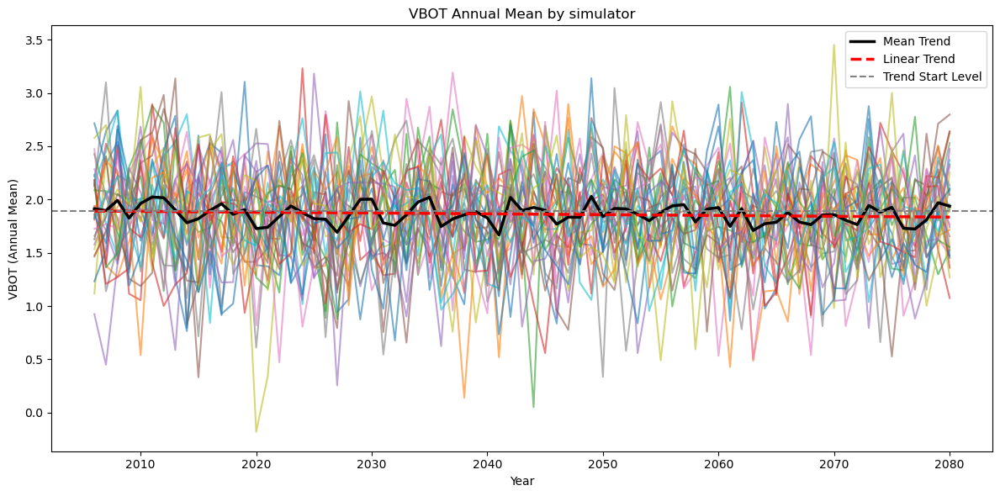

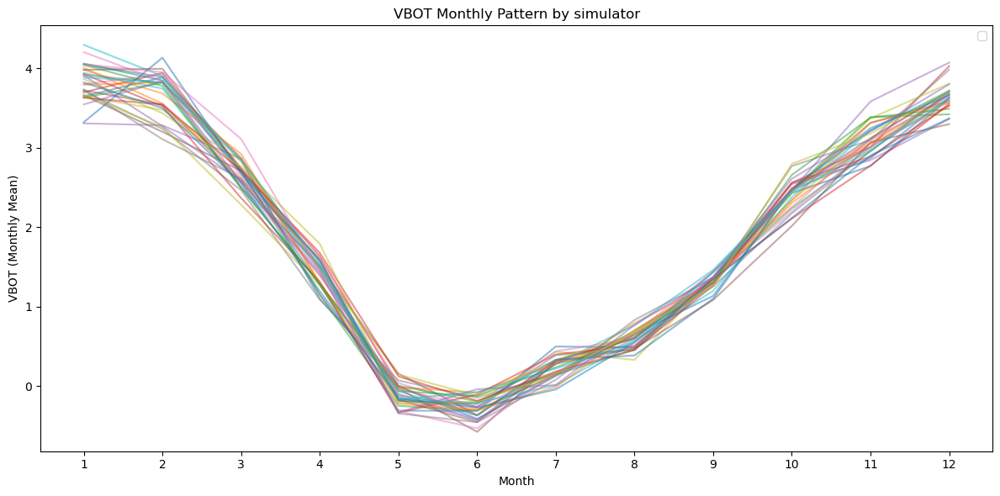

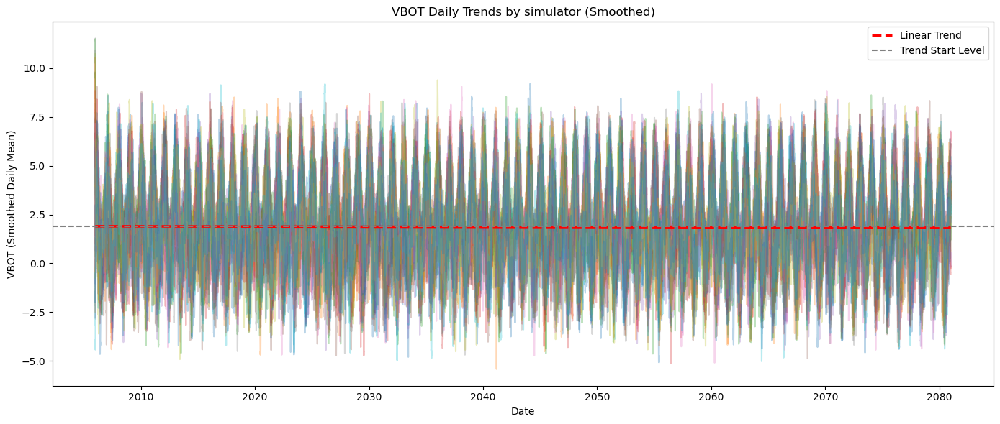

In [41]:
# Visualise Temporal Trends of `VBOT`
plot_variable_trends("VBOT",file_type="UKonly")

### Temporal Comparison of nc files (Early vs Late Periods)

In [42]:
# Define the early and late periods
early_years = list(range(2006, 2016))    # Early decade: 2006–2015
later_years = list(range(2071, 2081))    # Later decade: 2071–2080

# Define the variables you want to compare
target_vars = [
    "TREFMXAV_U", "TREFHT", "FLNS", "FSNS", "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]

# Get all UK-only NetCDF files
uk_files = sorted(glob.glob("*_UKonly_with_ymd.nc"))

# Loop through each variable
for var_name in target_vars:
    print(f"\n{var_name}")

    early_means = []
    later_means = []

    for file in uk_files:
        ds = xr.open_dataset(file, decode_times=False)
        if var_name not in ds.data_vars:
            continue
        
        # Convert to DataFrame and extract date
        df = ds.to_dataframe().reset_index()
        df = df.dropna(subset=[var_name])
        df['date'] = pd.to_datetime(df[['year', 'month', 'day']])

        # Compute early and later means
        early = df[df['date'].dt.year.isin(early_years)][var_name].mean()
        later = df[df['date'].dt.year.isin(later_years)][var_name].mean()

        early_means.append(early)
        later_means.append(later)

    # Create result table
    delta = np.array(later_means) - np.array(early_means)
    result_df = pd.DataFrame({
        "early": early_means,
        "later": later_means,
        "delta": delta
    })

    # Summary statistics
    percent_change = ((result_df["delta"] / result_df["early"]) * 100).mean()
    delta_std = result_df["delta"].std()

    # Print result
    print(f"Average change (%) {percent_change:.6f}")
    print(f"Delta std: {delta_std:.8f}\n")
    display(result_df)



TREFMXAV_U
Average change (%) 0.881308
Delta std: 0.24664305



,early,later,delta
0,287.372437,289.853302,2.480865
1,287.262909,290.044617,2.781708
2,287.301575,289.839417,2.537842
3,287.663300,290.240845,2.577545
4,287.140625,289.881287,2.740662
5,287.415161,289.755676,2.340515
6,287.763245,290.061188,2.297943
7,287.252563,289.848541,2.595978
8,287.246368,289.903717,2.657349
9,287.833527,289.679413,1.845886



TREFHT
Average change (%) 0.816900
Delta std: 0.23746100



,early,later,delta
0,284.004517,286.243652,2.239136
1,283.925201,286.490234,2.565033
2,284.004517,286.329926,2.325409
3,284.261993,286.650085,2.388092
4,283.808868,286.280029,2.471161
5,284.060394,286.206238,2.145844
6,284.381439,286.488770,2.107330
7,283.901123,286.290955,2.389832
8,283.900024,286.327332,2.427307
9,284.465820,286.112488,1.646667



FLNS
Average change (%) -1.730570
Delta std: 0.48115224



,early,later,delta
0,50.129307,48.641254,-1.488052
1,49.486153,48.888390,-0.597763
2,48.697369,48.674870,-0.022499
3,50.035358,49.403694,-0.631664
4,49.047241,48.982327,-0.064915
5,49.209408,47.954929,-1.254478
6,49.819969,49.321144,-0.498825
7,50.063580,48.293453,-1.770126
8,49.921944,48.895180,-1.026764
9,49.667831,48.301182,-1.366650



FSNS
Average change (%) 6.051507
Delta std: 1.02166724



,early,later,delta
0,106.333504,112.262192,5.928688
1,105.500786,112.611641,7.110855
2,104.675919,111.666985,6.991066
3,106.943146,113.910507,6.967361
4,104.692451,112.379204,7.686752
5,105.358276,110.140427,4.782150
6,106.687698,113.319382,6.631683
7,106.546967,111.255524,4.708557
8,106.443306,112.850891,6.407585
9,106.526871,111.214218,4.687347



QBOT
Average change (%) 15.792251
Delta std: 0.00010973



,early,later,delta
0,0.006218,0.007167,0.000949
1,0.006196,0.007320,0.001124
2,0.006289,0.007223,0.000934
3,0.006313,0.007305,0.000993
4,0.006168,0.007140,0.000972
5,0.006279,0.007165,0.000886
6,0.006413,0.007270,0.000857
7,0.006192,0.007218,0.001026
8,0.006191,0.007200,0.001009
9,0.006399,0.007127,0.000728



UBOT
Average change (%) 23.089151
Delta std: 0.30431813



,early,later,delta
0,1.626608,2.303833,0.677226
1,1.482592,2.114886,0.632294
2,1.527212,2.212376,0.685165
3,1.911839,2.507130,0.595290
4,1.433633,2.505965,1.072331
5,2.070509,2.562092,0.491582
6,1.770892,2.013613,0.242721
7,1.837673,2.069244,0.231571
8,1.806780,2.170981,0.364201
9,2.170214,2.241077,0.070863



VBOT
Average change (%) -2.490473
Delta std: 0.21354461



,early,later,delta
0,1.955148,1.828269,-0.126879
1,1.889172,1.929861,0.040689
2,2.018281,1.742010,-0.276271
3,1.959996,2.002185,0.042189
4,1.512962,1.931282,0.418320
5,1.673166,1.966775,0.293609
6,2.077326,1.684959,-0.392367
7,1.831280,1.761210,-0.070069
8,1.806032,1.881009,0.074977
9,2.076860,1.785552,-0.291308



PRECT
Average change (%) 4.762190
Delta std: 0.00000000



,early,later,delta
0,3.680438e-08,3.688675e-08,8.236611e-11
1,3.610342e-08,3.865293e-08,2.549509e-09
2,3.773965e-08,3.970739e-08,1.967742e-09
3,3.626088e-08,3.840900e-08,2.148123e-09
4,3.713393e-08,3.897427e-08,1.840341e-09
5,3.759342e-08,3.941075e-08,1.817337e-09
6,3.755023e-08,3.841330e-08,8.630714e-10
7,3.744792e-08,3.899795e-08,1.550024e-09
8,3.671152e-08,3.890114e-08,2.189623e-09
9,3.761301e-08,3.901702e-08,1.404015e-09



PRSN
Average change (%) -83.974495
Delta std: 0.00000000



,early,later,delta
0,3.949570e-10,9.244185e-11,-3.025151e-10
1,5.140695e-10,7.001227e-11,-4.440572e-10
2,4.318245e-10,4.607096e-11,-3.857535e-10
3,4.001522e-10,5.599275e-11,-3.441594e-10
4,6.156506e-10,7.367306e-11,-5.419776e-10
5,5.068684e-10,6.419854e-11,-4.426699e-10
6,5.173935e-10,8.100840e-11,-4.363851e-10
7,4.791336e-10,7.827874e-11,-4.008549e-10
8,6.608158e-10,6.534159e-11,-5.954742e-10
9,3.088266e-10,9.687558e-11,-2.119510e-10


## Multivariate analysis

### Pairwise Scatter Plot

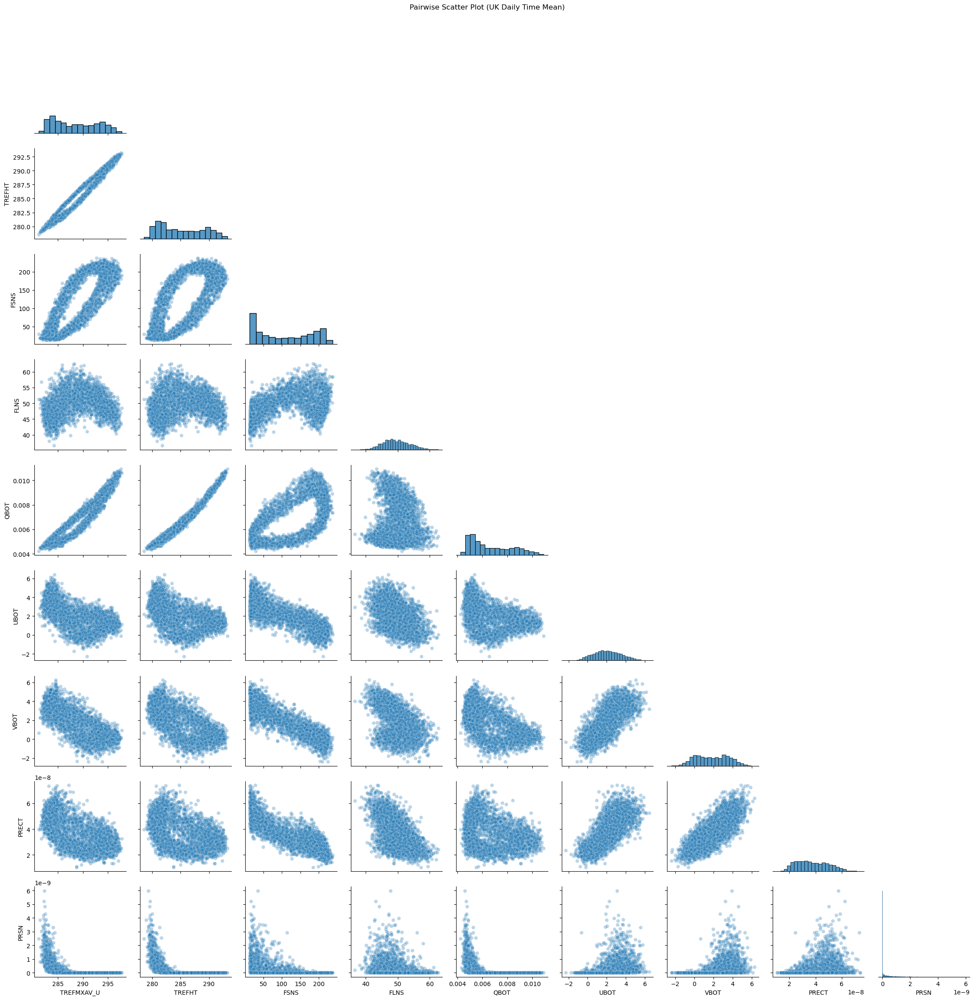

In [43]:
# Load the UK daily mean dataset
ds = xr.open_dataset("Mean_time_UK_only.nc")

# Convert to DataFrame
df = ds.to_dataframe().reset_index()

# Define the list of variables to analyze
var_list = [
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]

# Drop rows with missing values
plot_df = df[var_list].dropna()

# Optional sampling for performance (faster plotting)
plot_df = plot_df.sample(3000, random_state=42)

# Create pairwise scatter plot
sns.pairplot(plot_df, corner=True, plot_kws={'alpha': 0.3})
plt.suptitle("Pairwise Scatter Plot (UK Daily Time Mean)", y=1.02)
plt.tight_layout()
plt.show()


Many variables exhibit non-linear or monotonic relationships, as observed in the pairwise scatter plots. In addition, some variables, such as PRECT and PRSN, show strongly skewed distributions, often containing a large number of zero values. Moreover, Spearman correlation is more robust to outliers, making it a more reliable choice under these data conditions.

### Box Plots

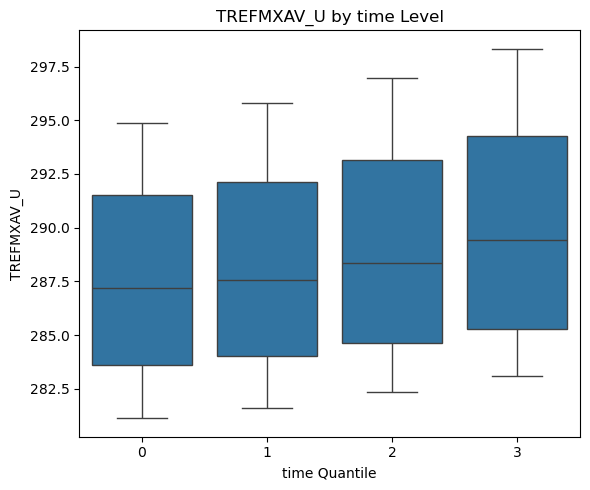

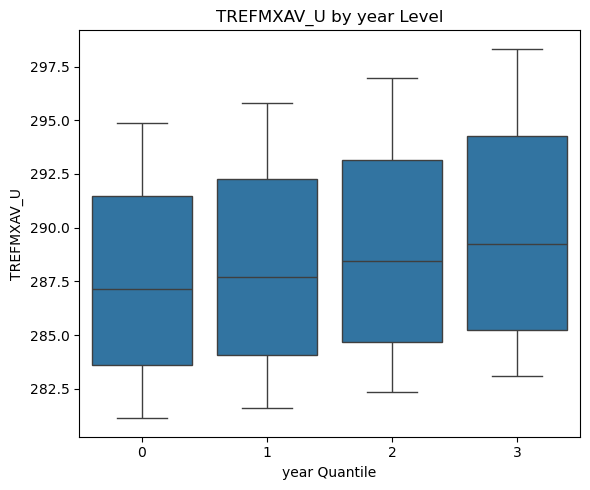

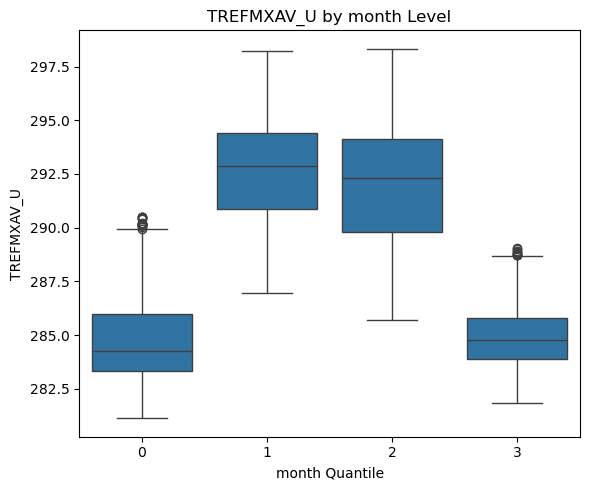

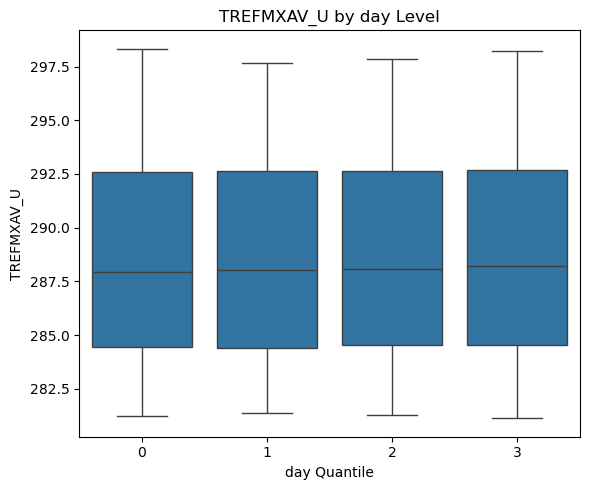

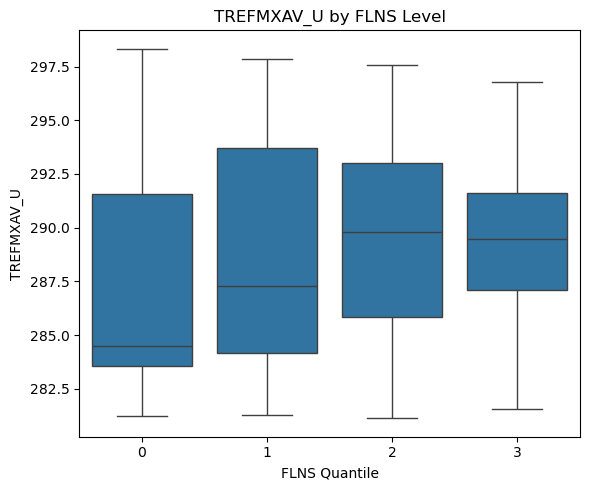

...

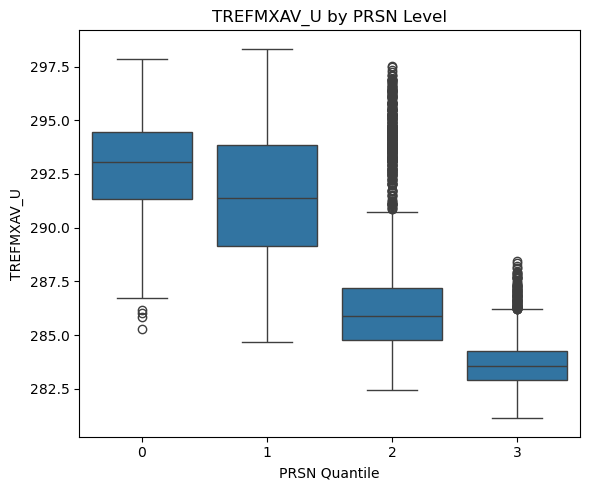

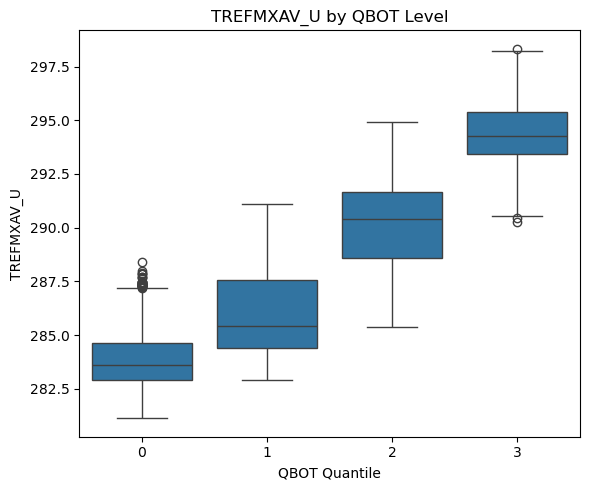

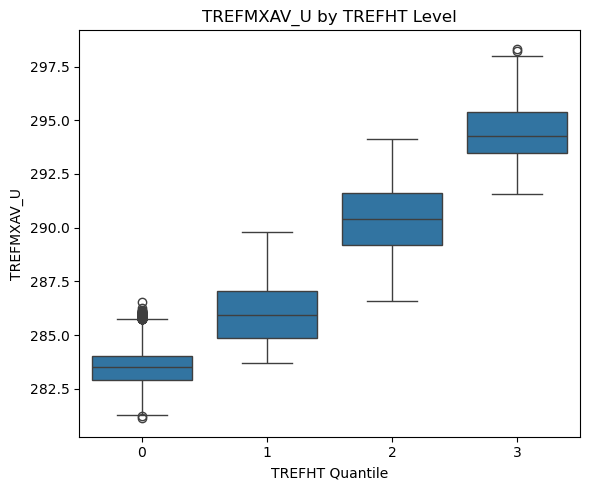

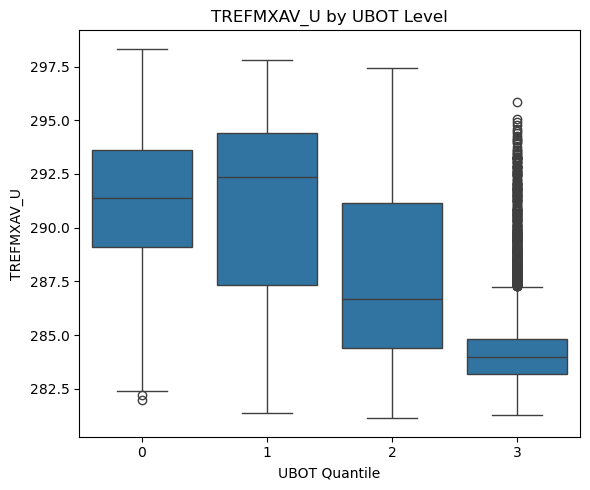

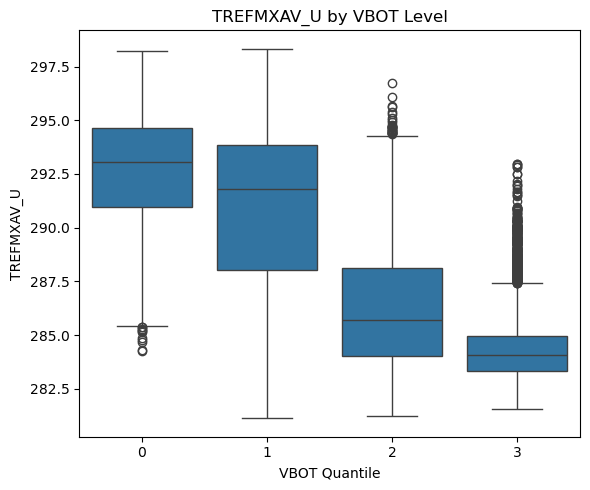

In [44]:
# Target variable for boxplots
target = "TREFMXAV_U"

# Select all feature variables except the target
variables = [col for col in df.columns if col != target]

# Loop through each variable and plot quantile-based boxplots
for var in variables:
    try:
        # Divide the variable into 4 quantile bins
        df[f"{var}_bin"] = pd.qcut(df[var], q=4, labels=False, duplicates="drop")
        
        # Plot the boxplot
        plt.figure(figsize=(6, 5))
        sns.boxplot(data=df, x=f"{var}_bin", y=target)
        plt.xlabel(f"{var} Quantile")
        plt.ylabel(f"{target}")
        plt.title(f"{target} by {var} Level")
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Skipped variable {var} due to error: {e}")


### Correlation Matrix & VIF

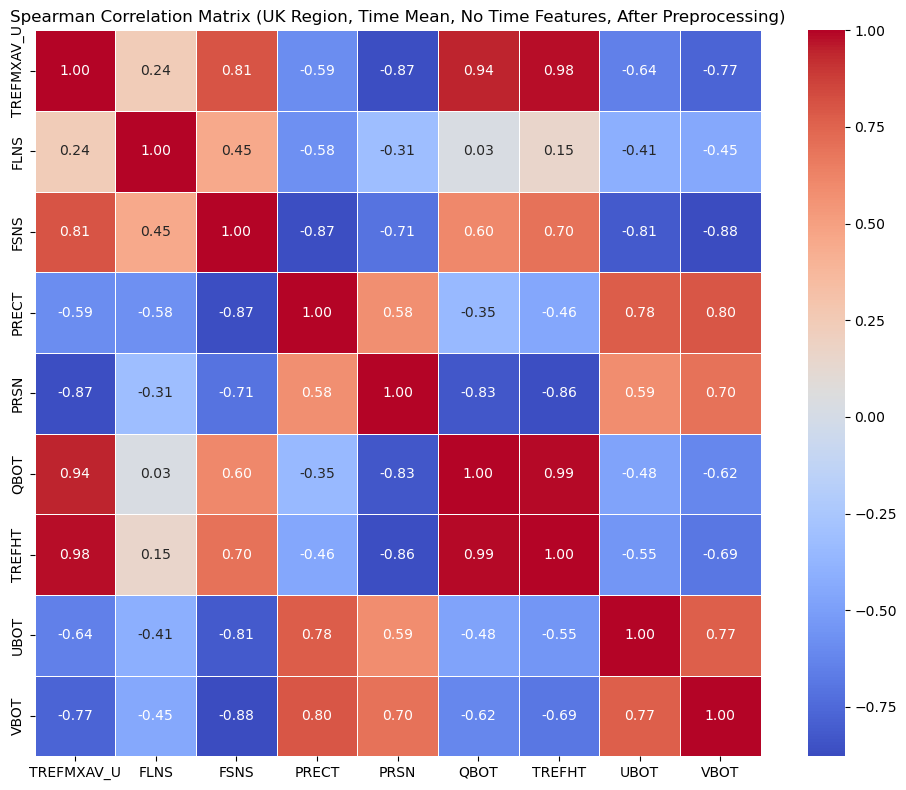

In [45]:
# Compute Spearman correlation matrix
# Load UK-only time-mean dataset
ds = xr.open_dataset("Mean_time_UK_only.nc")

# Convert to DataFrame
df = ds.to_dataframe().reset_index(drop=True)

# Drop time-related columns if present
df = df.drop(columns=[col for col in ['day', 'month', 'year'] if col in df.columns])

# Drop rows with missing values
df_clean = df.dropna()

# Compute Spearman correlation
corr = df_clean.corr(method='spearman')

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, fmt=".2f", cmap="coolwarm", square=True, linewidths=0.5)
plt.title("Spearman Correlation Matrix (UK Region, Time Mean, No Time Features, After Preprocessing)")
plt.tight_layout()
plt.show()


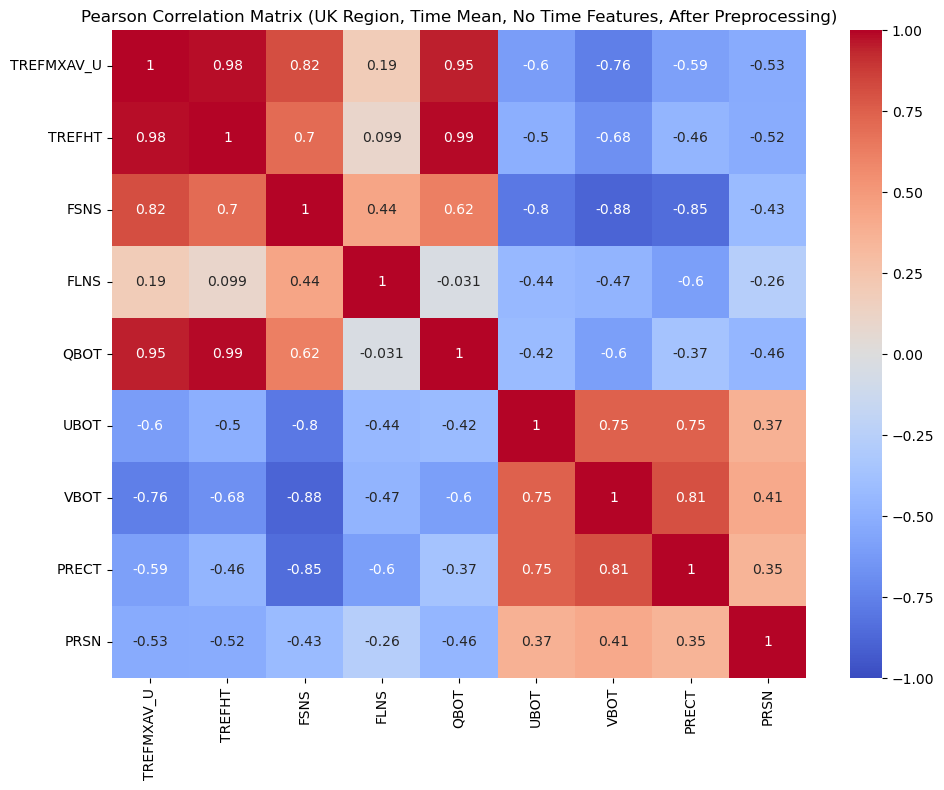

In [46]:
# Compute Pearson correlation matrix
pearson_corr = plot_df.corr(method='pearson')

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pearson_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Pearson Correlation Matrix (UK Region, Time Mean, No Time Features, After Preprocessing)")
plt.tight_layout()
plt.show()


In [47]:
# Variance Inflation Factor (VIF) Analysis
# Load dataset and convert to DataFrame
ds = xr.open_dataset("Mean_time_UK_only.nc")
df = ds.to_dataframe().reset_index()

# Select relevant variables and drop NaNs
features = [
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]
df = df[features].dropna()

# Compute VIFs for explanatory variables (exclude target)
X = df.drop(columns="TREFMXAV_U")  # exclude the target variable
vif_data = pd.DataFrame()
vif_data["Variable"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

# Show VIF results
print(vif_data.sort_values("VIF", ascending=False))


  Variable         VIF
0   TREFHT  651.123416
2     FLNS  288.453323
6    PRECT   53.899931
3     QBOT   53.600558
1     FSNS   27.526878
5     VBOT   11.730121
4     UBOT    9.037826
7     PRSN    1.710201


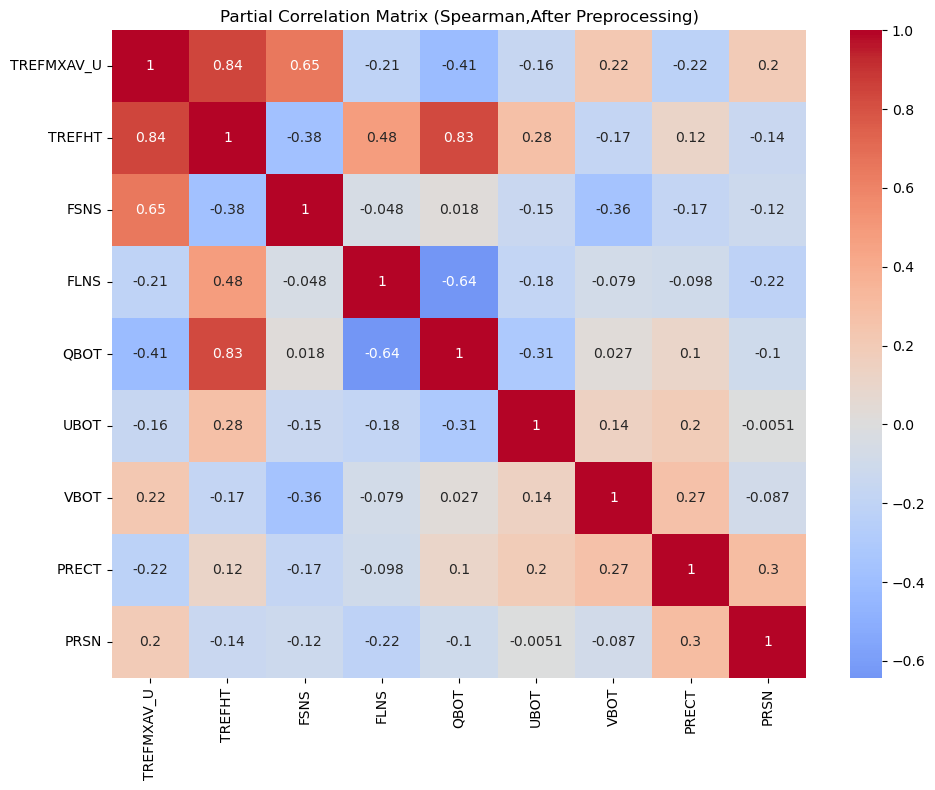

In [48]:
# Partial correlation matrix
features = df[[
    "TREFMXAV_U", "TREFHT", "FSNS", "FLNS", 
    "QBOT", "UBOT", "VBOT", "PRECT", "PRSN"
]].dropna()

# Calculate partial correlation matrix for all features
partial_corr_matrix = pd.DataFrame(index=features.columns, columns=features.columns)

for var1 in features.columns:
    for var2 in features.columns:
        if var1 == var2:
            partial_corr_matrix.loc[var1, var2] = 1.0
        else:
            covars = [v for v in features.columns if v not in [var1, var2]]
            r = pg.partial_corr(data=features, x=var1, y=var2, covar=covars, method='spearman')['r'].values[0]
            partial_corr_matrix.loc[var1, var2] = r

partial_corr_matrix = partial_corr_matrix.astype(float)
# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(partial_corr_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Partial Correlation Matrix (Spearman,After Preprocessing)")
plt.tight_layout()
plt.show()
